In [176]:
# !wget https://www.dropbox.com/scl/fi/emnbgp40314ardrnhrzn6/task1_data.zip?rlkey=6t2o38p459xyg5m0ytznh4qul
# !unzip /content/task1_data.zip?rlkey=6t2o38p459xyg5m0ytznh4qul
# !cp -r /content/data /content/drive/MyDrive/mipt_bayes

zsh:1: no matches found: https://www.dropbox.com/scl/fi/emnbgp40314ardrnhrzn6/task1_data.zip?rlkey=6t2o38p459xyg5m0ytznh4qul
zsh:1: no matches found: /content/task1_data.zip?rlkey=6t2o38p459xyg5m0ytznh4qul
cp: /content/data: No such file or directory


In [1]:
import numpy as np
import pandas as pd
import sklearn

from joblib import Parallel, delayed

from sklearn import svm, linear_model
from sklearn.model_selection import cross_validate
from sklearn.metrics import make_scorer
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn import feature_selection, decomposition, ensemble, preprocessing
import matplotlib.pyplot as plt

In [2]:
def read_data(dataset_id, filename = './data/'):
    X_train = pd.read_csv(filename + 'task1_' + str(dataset_id )+ '_learn_X.csv', delimiter=' ', header=None)
    y_train = pd.read_csv(filename + 'task1_' + str(dataset_id) + '_learn_y.csv', delimiter=' ',header=None)
    return X_train.values, y_train.values.reshape(-1)

def read_test_data(dataset_id, filename = './data/'):
    X_test = pd.read_csv(filename + 'task1_' + str(dataset_id) + '_test_X.csv', delimiter=' ', header=None)
    return X_test.values

def save_predictions(model, dataset_id, filename = './Destination_Dir/data/'):
    print("FIX ME!!!!!!!!!!!!!!!!")
    X_test = pd.read_csv(filename + 'task1_' + str(dataset_id) + '_test_X.csv', delimiter=' ', header=None)
    y_test = model.predict(X_test.values)
    y_test = pd.DataFrame(y_test)
    y_test.to_csv(filename + 'task1_' + dataset_id + '_ans.csv')

def get_name(obj):
    return obj.__class__.__name__

def compute_scores(y_true, y_pred, score_functions):
    # compute scores for given score functions
    y_true = y_true.astype(int) # чтобы были int
    y_pred = y_pred.astype(int)
    scores = {f'{get_name(sf)}_{i}': sf(y_true, y_pred) for i, sf in enumerate(score_functions)}
    return scores




In [3]:
# Init dataframe
from scipy.stats import chisquare
from statsmodels.stats.multitest import multipletests

def Behjamin_hohberg(p_val, alpha):                              # вызывалка поправки
    _, pv, *_ = multipletests(p_val, alpha, method = 'fdr_bh')
    return pv

def chi2_test(a, b):
    df_bins = pd.DataFrame()
    _, bins = pd.qcut(a, q = 10, retbins= True)
    df_bins['bin'] = pd.cut(a, bins= bins).value_counts().index
    df_bins['a_bin'] = pd.cut(a, bins = bins).value_counts().values
    df_bins['b_bin'] = pd.cut(b, bins = bins).value_counts().values
    df_bins['expected'] = df_bins['a_bin'] /np.sum(df_bins['a_bin']) *  np.sum(df_bins['b_bin'])
    stat, p_value = chisquare(df_bins['b_bin'], df_bins['expected'])
    return stat, p_value

def similarity_cross_test(X, f):
    # X.shape = (n_items, n_features)
    if not isinstance(X, pd.DataFrame):
        X = pd.DataFrame(X)
    rez = pd.DataFrame(index= X.columns, columns= X.columns)
    for col in  range(len(X.columns)):
        for row in range(len(X.columns)):
            rez.iloc[row,col] = f(X.iloc[:,row], X.iloc[:, col])
    return rez

def similarity_test(X, y, f):
    # X.shape = (n_items, n_features)
    if not isinstance(X, pd.DataFrame):
        X = pd.DataFrame(X)
    rez = pd.DataFrame(index= X.columns, columns= ['stat', 'p_value'])
    for ind in range(len(X.columns)):
        rez.iloc[ind] = f(X.iloc[:,ind][y > 0], X.iloc[:,ind][y == 0])
    return rez

In [4]:
# score functionss
from typing import Any


class ACC:
    def __init__(self):
        self.__name__ = self.__class__.__name__
    def __call__(self, y_true, y_pred) -> float:
        return np.mean(y_true == y_pred)
    def prob_to_class(self, y_prob):
        return (y_prob > 0.5 ).astype(int)
    
class ASY:
    def __init__(self, P) -> None:
        self.P = P
        self.__name__ = self.__class__.__name__ + f'_{P}'
        self.p = self.pred_p()
    def pred_p(self):
        score =( np.array([0, 1]) @ self.P @ np.array([-1., 1.]).T )/ (np.array([-1, 1]) @ self.P @ np.array([-1., 1.]).T )
        return 1 - score
    def prob_to_class(self, y_prob):
        return (y_prob > self.p).astype(int)
    def __call__(self, y_true, y_pred) -> float:
        return np.mean(self.P[np.round(y_true, 0).astype(int), np.round(y_pred, 0).astype(int)])

dfsdfsf

In [ ]:
sklearn.feature_selection.mutual_info_classif()

In [83]:
import warnings
warnings.filterwarnings("ignore")

import umap
import seaborn as sbn
from sklearn.manifold import trustworthiness

from sklearn.neighbors import LocalOutlierFactor
for dataset_id in [1, 7,11, 12]:
    print(f'dataset_id: {dataset_id}')
    # transformer = umap.UMAP(n_components= 5)

    X, y = read_data(dataset_id)
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)
    # m_inf = sklearn.feature_selection.chi2(X_train, y_train)
    # f_mes = sklearn.feature_selection.f_classif(X_train, y_train)[0]
    # utility = m_inf * f_mes
    # print(utility, m_inf.shape, f_mes.shape)
    # utility_ind = np.argsort(m_inf)[1]
    # print(utility_ind)
    k = 40 #X.shape[1]//4
    # X_train = X_train[:, utility_ind[-k:]]
    # X_test = X_test[:, utility_ind[-k:]]
    model = LocalOutlierFactor(novelty= True)
    model.fit(X_train)
    # print(utility[utility_ind[-k:]])
    print(dataset_id, np.mean(model.predict(X_train) > 0), np.mean(model.predict(X_test) > 0))


dataset_id: 1
1 1.0 1.0
dataset_id: 7
7 0.6111111111111112 0.64
dataset_id: 11
11 1.0 1.0
dataset_id: 12
12 1.0 1.0


In [134]:
def categorizer(X):
    # X = X - np.min(X, axis= 0) + 1e-3
    # X = np.log(X)
    scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
    X_cat = np.zeros_like(X)
    X_cat = (X < 0.5)
    # for i in range(10):
        # X_cat += ((X > i - 0.5) & (X < i + 0.5)) * i
    return X_cat

tmp = np.array([[1.01, 1.99, 3.99],[7.02, 6.001, 4.03]])
categorizer(tmp)

array([[False, False, False],
       [False, False, False]])

In [371]:
def categorizer(X):
    # X = X - np.min(X, axis= 0) + 1e-3
    # X = np.log(X)
    scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
    X_cat = np.zeros_like(X)
    X_cat = (X < 0.5)
    # for i in range(10):
        # X_cat += ((X > i - 0.5) & (X < i + 0.5)) * i
    return X_cat

tmp = np.array([[1.01, 1.99, 3.99],[7.02, 6.001, 4.03]])
categorizer(tmp)


dataset_id = 8
X, y = read_data(dataset_id)
y = y > 0.5
# X = X[:, :10]
X = X - np.min(X, axis= 0) + 1e-3
X = np.log(X)
scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
X = scaler.transform(X)
# X = (X < 0.5)

inverted = [(np.mean(X[:, i][y]) > np.mean(X[:, i][~y])) for i in range(X.shape[1])]

classif = np.any(X * inverted, axis= 1)
np.mean(classif == y)
# data = pd.DataFrame(X)
# data['target'] = y
# sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 

0.202

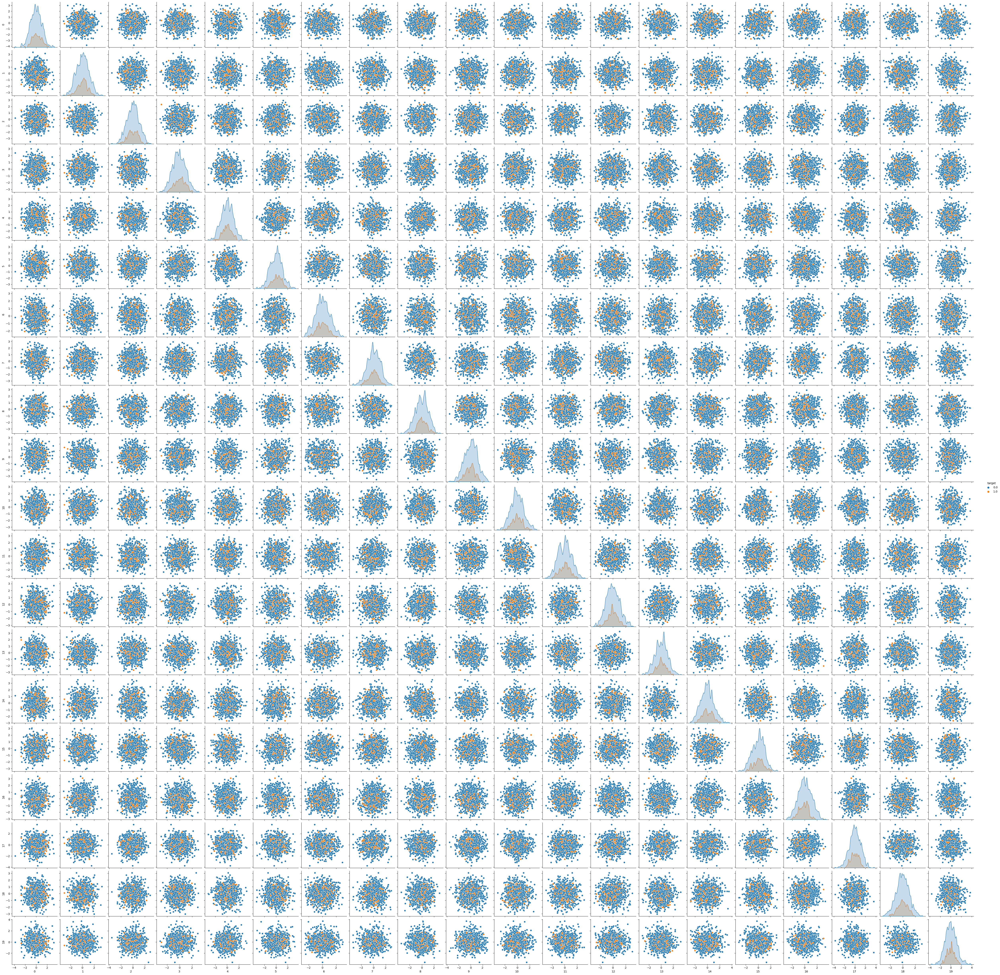

In [430]:
dataset_id = 11
X, y = read_data(dataset_id)
# scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
# X = scaler.transform(X)
data = pd.DataFrame(X)
data['target'] = y
sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 

In [354]:
np.sum(np.all(X > 0.5, axis= 1) == y)

643

In [21]:
import warnings
warnings.filterwarnings("ignore")

import umap
import seaborn as sbn
from sklearn.manifold import trustworthiness

from sklearn.neighbors import LocalOutlierFactor
for dataset_id in [1]:
    print(f'dataset_id: {dataset_id}')
    transformer = umap.UMAP(n_components= 5)

    X, y = read_data(dataset_id)
    # pca = PCA(n_components= 1)
    # X = pca.fit_transform(X, y)
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)
    # X_train_tr = transformer.fit_transform(X_train, y_train)
    # X_test_tr = transformer.transform(X_test)
    model = LocalOutlierFactor(novelty= True)
    model.fit(X_train)
    print(dataset_id, np.mean(model.predict(X_train) > 0), np.mean(model.predict(X_test) > 0))


dataset_id: 1
1 1.0 1.0


In [8]:
dataset_id = 8
print(f'dataset_id: {dataset_id}')
transformer = umap.UMAP(n_components= 5)

X, y = read_data(dataset_id)
# pca = PCA(n_components= 1)
# X = pca.fit_transform(X, y)
X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)
# X_train_tr = transformer.fit_transform(X_train, y_train)
# X_test_tr = transformer.transform(X_test)

dataset_id: 8
8 0.7066666666666667 0.72


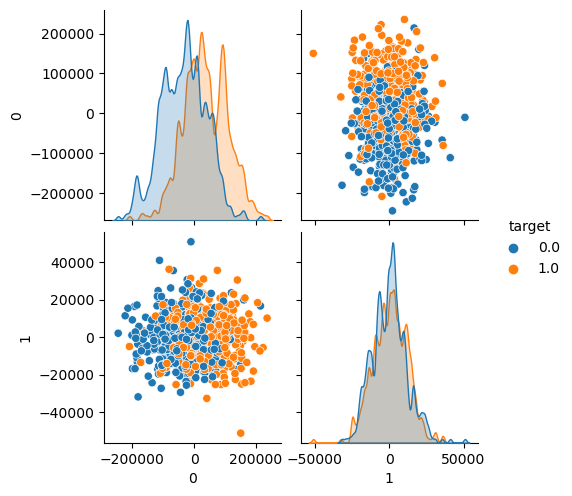

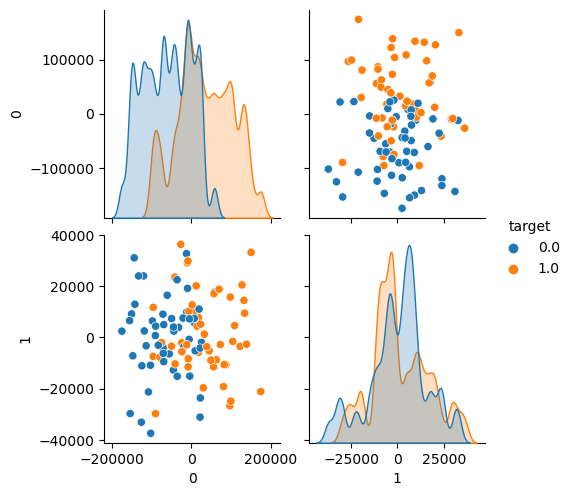

In [65]:
import warnings
warnings.filterwarnings("ignore")

from sammon import sammon
import umap
import seaborn as sbn

X, y = read_data(6)
X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)

# pca_res_tr, sammon_st = sammon.sammon(X_train)

X = pca_res_tr
data = pd.DataFrame(X)
data['target'] = y_train
sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 
plt.show() 

pca_res_tr, sammon_st = sammon.sammon(X_test)

X = pca_res_tr
data = pd.DataFrame(X)
data['target'] = y_test
sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 
plt.show() 
# dataset_id = 1
# print(f'dataset_id: {dataset_id}')
# transformer = umap.UMAP(n_components= 1)

# X, y = read_data(dataset_id)
# # pca = PCA(n_components= 1)
# # X = pca.fit_transform(X, y)
# X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)
# X_train = transformer.fit_transform(X_train, y_train)

# X = transformer.transform(X_test)
# data = pd.DataFrame(X)
# data['target'] = y_test
# sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 
# plt.show() 

# X = X_train
# data = pd.DataFrame(X)
# data['target'] = y_train
# sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 
# plt.show() 

In [102]:
from sklearn.mixture import GaussianMixture
X, y = read_data(1)
gm = GaussianMixture(n_components= 3).fit(X, y)
# print(gm.means_)
np.mean(gm.predict( X) != y)

0.688

In [80]:
np.logspace(start=-5, stop=2, num=1)

array([1.e-05])

In [9]:
def corr(x, y):
    numerator = ((x - x.mean(axis=-1, keepdims=True))*(y - y.mean(axis=-1, keepdims=True))).sum(axis=-1)
    denominator = (np.sum((x - x.mean(axis=-1, keepdims=True))**2, axis=-1) * np.sum((y - y.mean(axis=-1, keepdims=True))**2, axis=-1)) ** 0.5
    return numerator / denominator

dataset_id = 14
X, y = read_data(dataset_id)
corrs = corr(sklearn.decomposition.PCA(n_components=50).fit_transform(StandardScaler().fit_transform(X), y).T, y)
corrs

array([-0.06692556, -0.02874346,  0.03140142,  0.09790509,  0.07584621,
        0.04517125,  0.03310013, -0.0177259 ,  0.02611762, -0.0839016 ,
       -0.02683868, -0.00083248,  0.02120573, -0.03522519, -0.02238093,
       -0.08512144,  0.0833918 ,  0.05517035,  0.01780182, -0.0446265 ,
       -0.03456799, -0.11243957, -0.03413103, -0.03841705, -0.05504448,
        0.0230939 , -0.02217888,  0.05948171, -0.01237116,  0.02533873,
        0.05561113,  0.04060578,  0.03176127, -0.00098156, -0.00721558,
        0.08314166,  0.04248121, -0.02517218, -0.06245494,  0.02375963,
       -0.05849217,  0.00723196, -0.01483678, -0.05892027,  0.01347231,
        0.02055248, -0.04414588, -0.06488932,  0.12178869, -0.00035996])

In [22]:

from itertools import product
var_smoothings = np.logspace(start=-1, stop=2, num=20)
priors = np.linspace(start=0.01, stop = 0.05, num = 20 )

param_grid = product(var_smoothings,priors)
for elem in param_grid:
    print(elem)
    break

(0.1, 0.01)


In [51]:
asy = ASY(np.array([[-9, 9],[1, 0]]),)
dataset_id = 1
X, y = read_data(dataset_id)
X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.2, stratify = y, shuffle=True)
var_smoothings = np.logspace(start=-6, stop=1, num=200)
priors = np.linspace(start=0.001, stop = 1 - 0.001, num = 200 )
param_grid = product(var_smoothings, priors)
best_model = None
best_scores = [-1, 0, 100, 100 ]
# for var_smoothing in var_smoothings:
for elem in param_grid:
    var_smoothing, prior = elem
    model = make_pipeline(
        sklearn.preprocessing.MinMaxScaler(),
        GaussianNB(priors= (prior, 1 - prior), var_smoothing = var_smoothing) #, priors=[0.9, 0.1])
    )
    model.fit(X_train, y_train)
    probs = model.predict_proba(X_test)[:, 1]
    score = asy(y_test, y_prob=probs)
    if score < -4:
        print(asy(y_test, y_prob=probs))


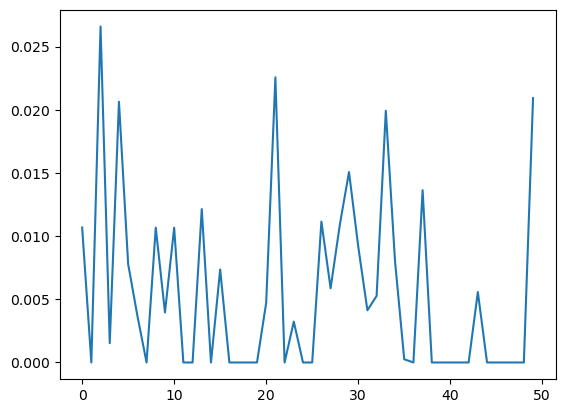

In [34]:
dataset_id = 7
X, y = read_data(dataset_id)
selector = sklearn.feature_selection.SelectKBest( sklearn.feature_selection.mutual_info_classif,k = X.shape[1]//3).fit(X, y)

plt.plot(selector.scores_)
plt.show()

In [12]:
a = np.array([3,4, 100,5,2,1])
b = np.argsort(a)
a[b[-3:]]

array([  4,   5, 100])

In [8]:
import umap
from skrvm import RVC

# import umap
import seaborn as sbn
from joblib import Parallel, delayed
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import top_k_accuracy_score
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans

from itertools import product

from copy import deepcopy

best_models = {}
score_functions = [ACC(), None,  ASY(np.array([[-9, 9],[1, 0]]),), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]
def generate_features(data, means):
    return np.linalg.norm(data[:, None, :] - means[None, :, :], axis= 2)

def score_dataset(dataset_id):
    print(f"start: {dataset_id}")
    X, y = read_data(dataset_id)
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.2, stratify = y, shuffle=True)
    
    k_s = [5, 7, 9, 12, 15, 20]
    metrics_ = [sklearn.feature_selection.mutual_info_classif,
                sklearn.feature_selection.f_classif,]
    # priors = np.linspace(start=0.001, stop = 1 - 0.001, num = 1 )
    param_grid = product(k_s,metrics_ )
    best_scores = [-1, 0, 100, 100 ]
    # for var_smoothing in var_smoothings:
    
    for elem in param_grid:
        k, metric = elem
        for _ in range(5):
            # var_smoothing, prior = elem
            model = make_pipeline(
                sklearn.feature_selection.SelectKBest(metric, k = min(k, X.shape[1])), # X.shape[1]//3),
                sklearn.preprocessing.MinMaxScaler(),
                # umap.UMAP(30, 10),
                sklearn.linear_model.ARDRegression()
                # GaussianNB() #priors= (prior, 1 - prior), var_smoothing = var_smoothing) #, priors=[0.9, 0.1])

            )

            model.fit(X_train, y_train)
            # print(f'{dataset_id}: {model.score(X_train, y_train)} , {model.score(X_test, y_test)}')
            y_pred = model.predict(X_test) #, return_std = True)
            # print(y_pred)
            scores = []
            for i, scorer in enumerate(score_functions):
                if i == 1:
                    # print(model.predict_proba(X_test))
                    scores.append(sklearn.metrics.roc_auc_score(y_test, y_pred))
                elif i > 1:
                    scores.append(scorer(y_test, y_prob = y_pred))
                else:
                    scores.append(scorer(y_test, y_pred > 0.5))
                
                if (scores[i] > best_scores[i]) == greater_is_better[i]:
                    best_scores[i] = scores[i]
                    best_models[(dataset_id, i)] = deepcopy(model)
    best_scores = [np.mean(y_test < 0.5)] + best_scores
    print(f"   finish: {dataset_id}\n   results: {best_scores}")
    return best_scores, best_models

rez = []

score_dataset_del = delayed(score_dataset)
ids = [7, 8, 9] #list(range(1, 14))
rez = Parallel(n_jobs= 5)(score_dataset_del(dataset_id) for dataset_id in ids)
scores = [tmp[0] for tmp in rez]
best_models = [tmp[1] for tmp in rez]
df = pd.DataFrame(data = scores, index = ids, columns= ['baseline',"ACC", "AUC", "ASY1", "ASY2", 'param'])
for col in df.columns[:-1]:
    df[col] = df[col].apply(lambda x: round(x, 2))
df

start: 5
start: 4
start: 1
start: 7
   finish: 1
   results: [0.49, 0.5, 0.474889955982393, -3.9, 0.525]
   finish: 4
   results: [0.835, 0.835, 0.5924514607149338, -7.35, -0.505]
   finish: 7
   results: [0.87, 0.87, 0.5457559681697612, -7.7, -0.61]
   finish: 5
   results: [0.625, 0.875, 0.9550933333333333, -5.33, -0.62]


ValueError: 6 columns passed, passed data had 5 columns

## faster work with K best

In [406]:
import umap
from skrvm import RVC

# import umap
import seaborn as sbn
from joblib import Parallel, delayed
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import top_k_accuracy_score
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans

from itertools import product

from copy import deepcopy

best_models = {}
score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]


def get_scores(X, y, model):
    probs = model.predict(X)
    scores = []
    for i, scorer in enumerate(score_functions):
        if i != 0:
            y_pred = scorer.prob_to_class(probs)
        else:
            y_pred = probs
        scores.append(scorer(y, y_pred))
    return scores

def generate_features(data, means):
    return np.linalg.norm(data[:, None, :] - means[None, :, :], axis= 2)

def score_dataset(dataset_id):
    print(f"start: {dataset_id}")
    X, y = read_data(dataset_id)
    X_train_, X_test_val, y_train, y_test_val = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)
    X_test_, X_val_, y_test, y_val =  sklearn.model_selection.train_test_split(X_test_val, y_test_val, test_size= 0.5, stratify = y_test_val, shuffle=True)

    kmeans = sklearn.neighbors.NearestCentroid().fit(X_train_, y_train)
    means = kmeans.centroids_
    # X_train_ = generate_features(X_train_, means)
    # X_test_ = generate_features(X_test_, means)
    # X_val_ = generate_features(X_val_, means)
    # pca =   umap.UMAP(n_components= n_features).fit(X_train_)#sklearn.decomposition.PCA().fit(X_train_, y_train)
    # X_train_ = pca.transform(X_train_)
    # X_test_ = pca.transform(X_test_)
    # X_val_ = pca.transform(X_val_)

    n_features = X_train_.shape[1]
    k_s = list(range(3, n_features + 1))
    metrics_ = [sklearn.feature_selection.mutual_info_classif,
                sklearn.feature_selection.f_classif,]
    models = [ sklearn.linear_model.ARDRegression(),
              GaussianNB(),
              svm.SVC()]
    best_scores = [-1, 0, 100, 100 ]
    test_scores = [-1, 0, 100, 100 ]
    # for var_smoothing in var_smoothings:
    
    for metric in metrics_:
        feature_selector = sklearn.feature_selection.KBest(metric, ).fit(X_train_, y_train)
        feature_scores = feature_selector.scores_
        feature_indices = np.argsort(feature_scores)
        for k in k_s:
            X_train = X_train_[:,feature_indices[-k:]]
            X_val  = X_val_[:, feature_indices[-k:]]
            X_test = X_test_[:, feature_indices[-k:]]
            for _ in range(1):
                for md in models:
                    model = make_pipeline(
                        sklearn.preprocessing.MinMaxScaler(),
                        md
                    )

                    model.fit(X_train, y_train)
                    scores = get_scores(X_val, y_val, model)
                    test_scores_tmp = get_scores(X_test, y_test, model)
                    for i in range(len(score_functions)):
                        if (scores[i] > best_scores[i]) == greater_is_better[i]:
                            best_scores[i] = scores[i]
                            test_scores[i] = test_scores_tmp[i]
                            best_models[(dataset_id, i)] = deepcopy([feature_indices[-k: ], model])
                
    best_scores = [np.mean(y_val < 0.5)] + best_scores
    test_scores = [np.mean(y_test < 0.5)] + test_scores
    print(f"   finish: {dataset_id}\n   results: {best_scores}")
    return best_scores, test_scores, best_models

rez = []

score_dataset_del = delayed(score_dataset)
ids = [8] #

rez = Parallel(n_jobs= 5)(score_dataset_del(dataset_id) for dataset_id in ids)
scores = [tmp[0] for tmp in rez]
test_scores = [tmp[1] for tmp in rez]
best_models = [tmp[2] for tmp in rez]
df = pd.DataFrame(data = scores, index = ids, columns= ['baseline',"AUC", "ACC", "ASY1", "ASY2"])
for col in df.columns[:]:
    df[col] = df[col].apply(lambda x: round(x, 2))
display(df)

df = pd.DataFrame(data = test_scores, index = ids, columns= ['baseline',"AUC", "ACC", "ASY1", "ASY2"])
for col in df.columns[:]:
    df[col] = df[col].apply(lambda x: round(x, 2))
display(df)

start: 8


AttributeError: module 'sklearn.feature_selection' has no attribute 'KBest'

In [407]:
import umap
from skrvm import RVC

# import umap
import seaborn as sbn
from joblib import Parallel, delayed
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import top_k_accuracy_score
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans

from itertools import product

from copy import deepcopy

best_models = {}
score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]


def get_scores(X, y, model):
    probs = model.predict(X)
    scores = []
    for i, scorer in enumerate(score_functions):
        if i != 0:
            y_pred = scorer.prob_to_class(probs)
        else:
            y_pred = probs
        scores.append(scorer(y, y_pred))
    return scores

def generate_features(data, means):
    return np.linalg.norm(data[:, None, :] - means[None, :, :], axis= 2)

def score_dataset(dataset_id):
    print(f"start: {dataset_id}")
    X, y = read_data(dataset_id)
    X = X - np.min(X, axis= 0) + 1e-3
    X_train_, X_test_val, y_train, y_test_val = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)
    X_test_, X_val_, y_test, y_val =  sklearn.model_selection.train_test_split(X_test_val, y_test_val, test_size= 0.5, stratify = y_test_val, shuffle=True)

    scaler = make_pipeline(
        sklearn.preprocessing.MinMaxScaler(),
        sklearn.preprocessing.MinMaxScaler()
        ).fit(X_train_)
    X_train = scaler.transform(X_train_)**2
    X_test = scaler.transform(X_test_)**2
    X_val = scaler.transform(X_val_)**2
    # X_train = X_train**2


    metrics_ = [sklearn.feature_selection.mutual_info_classif,
                sklearn.feature_selection.f_classif,]
    models = [ sklearn.naive_bayes.ComplementNB(), sklearn.linear_model.ARDRegression(), ]
    best_scores = [-1, 0, 100, 100 ]
    test_scores = [-1, 0, 100, 100 ]
    # for var_smoothing in var_smoothings:

    for md in models:
        model = make_pipeline(
            md
        )

        model.fit(X_train, y_train)
        scores = get_scores(X_val, y_val, model)
        test_scores_tmp = get_scores(X_test, y_test, model)
        for i in range(len(score_functions)):
            if (scores[i] > best_scores[i]) == greater_is_better[i]:
                best_scores[i] = scores[i]
                test_scores[i] = test_scores_tmp[i]
                best_models[(dataset_id, i)] = deepcopy([1, model])
            
    best_scores = [np.mean(y_val < 0.5)] + best_scores
    test_scores = [np.mean(y_test < 0.5)] + test_scores
    print(f"   finish: {dataset_id}\n   results: {best_scores}")
    return best_scores, test_scores, best_models

rez = []

score_dataset_del = delayed(score_dataset)
ids = [8] #

rez = Parallel(n_jobs= 5)(score_dataset_del(dataset_id) for dataset_id in ids)
scores = [tmp[0] for tmp in rez]
test_scores = [tmp[1] for tmp in rez]
best_models = [tmp[2] for tmp in rez]
df = pd.DataFrame(data = scores, index = ids, columns= ['baseline',"AUC", "ACC", "ASY1", "ASY2"])
for col in df.columns[:]:
    df[col] = df[col].apply(lambda x: round(x, 2))
display(df)

df = pd.DataFrame(data = test_scores, index = ids, columns= ['baseline',"AUC", "ACC", "ASY1", "ASY2"])
for col in df.columns[:]:
    df[col] = df[col].apply(lambda x: round(x, 2))
display(df)

start: 8
   finish: 8
   results: [0.8, 0.575, 0.74, -4.9, -0.1]


,baseline,AUC,ACC,ASY1,ASY2
8,0.8,0.57,0.74,-4.9,-0.1


,baseline,AUC,ACC,ASY1,ASY2
8,0.8,0.55,0.7,-4.18,0.06


In [408]:
best_models

[{(8, 0): [1, Pipeline(steps=[('complementnb', ComplementNB())])],
  (8, 1): [1, Pipeline(steps=[('complementnb', ComplementNB())])],
  (8, 2): [1, Pipeline(steps=[('complementnb', ComplementNB())])],
  (8, 3): [1, Pipeline(steps=[('complementnb', ComplementNB())])]}]

In [103]:
X, y = read_data(13)
X_train_, X_test_val, y_train, y_test_val = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)
X_test_, X_val_, y_test, y_val =  sklearn.model_selection.train_test_split(X_test_val, y_test_val, test_size= 0.5, stratify = y_test_val, shuffle=True)

from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.neighbors import KNeighborsClassifier
from sklearn.datasets import load_iris
# X, y = load_iris(return_X_y=True)

model = make_pipeline(
    sklearn.preprocessing.MinMaxScaler(),
    sklearn.linear_model.ARDRegression(),
)
sfs = SequentialFeatureSelector(model, n_features_to_select=3)
sfs.fit(X_train_, y_train)
sfs.get_support()
sfs.transform(X).shape

(1000, 3)

In [33]:
out_path_i = "test_ans/task1_{dataset_id}_ans.csv"
ids = [7, 8, 9, 10]

score_functions = [sklearn.metrics.roc_auc_score, ACC(),  ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
func_names = ["AUC", "ACC", "ASY1", "ASY2"]
greater_is_better = [True, True, False, False]

def get_preds(dataset_id, best_model_for_score):
    X_, y = read_data(dataset_id)
    X_test_ = read_test_data(dataset_id)
    predictions = pd.DataFrame()
    for i, scorer in enumerate(score_functions):
        model_params = best_model_for_score[(dataset_id, i)]
        X = X_[:, model_params[0]]
        X_test = X_test_[:, model_params[0]]
        model = model_params[1].fit(X, y)
        probs = model.predict(X_test)

        if i != 0:
            y_pred = scorer.prob_to_class(probs)
        else:
            y_pred = probs

        print(func_names[i])
        predictions[func_names[i]] = y_pred
    return predictions


for i, dataset_id in enumerate(ids):
    path = out_path_i.format(dataset_id=dataset_id)
    out_df = get_preds(dataset_id, best_models[i])
    out_df.to_csv(path, index=False)

AUC
ACC
ASY1
ASY2
AUC
ACC
ASY1
ASY2
AUC
ACC
ASY1
ASY2
AUC
ACC
ASY1
ASY2


CROSSVAL

In [383]:
dataset_id = 8
X, y = read_data(dataset_id)
y = y > 0.5
# X = X[:, :10]
X = X - np.min(X, axis= 0) + 1e-3
X = np.log(X)
scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
X = scaler.transform(X)
X = (X < 0.5)

inverted = np.array([(np.mean(X[:, i][y]) > np.mean(X[:, i][~y])) for i in range(X.shape[1])])

classif = np.any(X[:, inverted], axis= 1) | np.all(X[:, ~inverted], axis= 1) 
np.mean(classif == y)

0.958

In [400]:
dataset_id = 8
X, y = read_data(dataset_id)
mmin =  np.min(X, axis= 0)
X = X - np.min(X, axis= 0) + 1e-3
X = np.log(X)
scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
X = scaler.transform(X)
X = X < 0.5
dummies = []
dummies_ind = []
for i in range(X.shape[1]):
    if np.sum(X[:, i] != 0) > 1:
        dummies.append(np.sum(X[:, i] == 0))
        dummies_ind.append(i)
print(len(dummies), dummies, dummies_ind)

3 [998, 996, 995] [821, 889, 1366]


In [88]:
dataset_id = 8
X, y = read_data(dataset_id)
scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
X = scaler.transform(X)
tmp = []
for i in range(X.shape[1]):
    tmp.append(np.quantile(X[:, i], 0.95))
nums = np.argsort(tmp)

In [89]:
feats = []
for feature in range(X.shape[1]):
    if np.any(np.abs(X[y == 1][:, feature] - np.mean(X[:, feature])) > 0.05):
        feats.append(np.sum(np.abs(X[y == 1][:, feature] - np.mean(X[:, feature])) > 0.1))
print(sum(feats))

1805


In [90]:
means = X.mean(axis = 0)

preds = np.any(np.abs(X - means) > 0.05, axis = 1)
np.mean(preds == y)


0.202

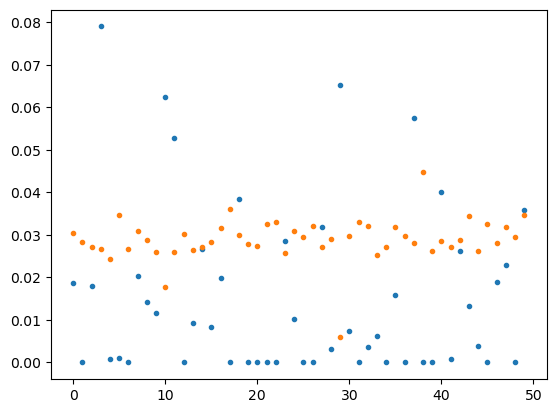

In [201]:
dataset_id = 7
X, y = read_data(dataset_id)
scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
X = scaler.transform(X)

a = np.std(X[y == 1], axis=0)
b = np.std(X[y == 0], axis = 0)

plt.plot(a, '.')
plt.plot(b, '.')

In [225]:
tmp

array([[15,  4, 19, ..., 43, 38, 13],
       [15,  4, 19, ..., 43, 38, 47],
       [15,  4, 19, ..., 49, 43, 38],
       ...,
       [15,  4, 19, ..., 49, 43, 38],
       [15,  4, 19, ..., 43, 38, 33],
       [15,  4, 19, ..., 49, 43, 38]])

In [246]:
a = np.array([[3,2,1], [5,33,1]])
a = np.sort(a, 1)[:, -2:]
a[:, -1]/a[:, -2]

array([1.5, 6.6])

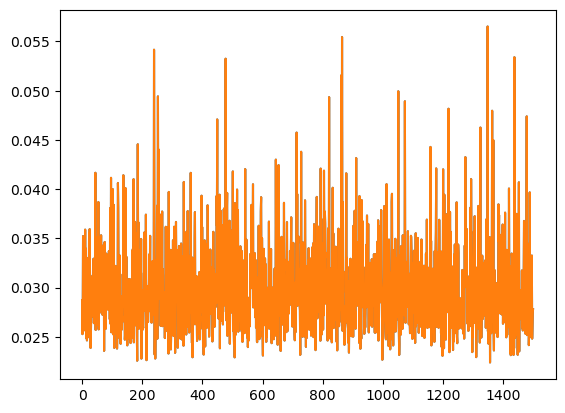

In [294]:
dataset_id = 8
X, y = read_data(dataset_id)
scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
X = scaler.transform(X)

means = np.mean(X, axis = 0)
tmp = np.abs(X - means)
tmp = np.mean(tmp**2, 0)**0.5
plt.plot(tmp)
plt.plot(tmp) #[y != 1])
# np.mean(solver == y)


solver

In [248]:
solver

array([  9.91561066,  38.29422321,   1.3600846 ,   1.3427466 ,
         6.19471443,   1.36156975,   1.35516347,   1.33990548,
         1.36308352,   1.3605291 ,  48.76606136,   1.3666891 ,
        12.677149  , 121.24265292,   1.36811519, 151.61364599,
         1.35396735,  47.03697529, 178.0019415 , 390.78940994,
       231.1335935 ,   1.37048707, 191.3551364 ,   1.34037783,
         1.36782472,   1.36913463,   1.34815863,   1.36714016,
         1.35833112, 146.49419504,  87.31076193,   1.3407708 ,
       387.42584093,   1.79341523,   1.36531184,   1.36471131,
        43.55228961,   1.33762734,   1.34812748,   1.36159311,
         1.35518861,   5.34007726,   1.35163646,   1.36832226,
         1.36944002,   8.10296569,   1.34717487,  11.27231606,
         1.33997162,   2.15422446,   1.3545569 ,   1.3605674 ,
         1.36206318,   1.35979239,   1.35012805,   1.35744631,
         1.35052892,   1.35465233,   1.36220888,   1.91373268,
         1.33848383,   1.36255258, 224.02389086,   1.36

In [252]:
y[:10]

array([0., 0., 1., 1., 0., 0., 0., 0., 0., 0.])

0.0007462051791835562

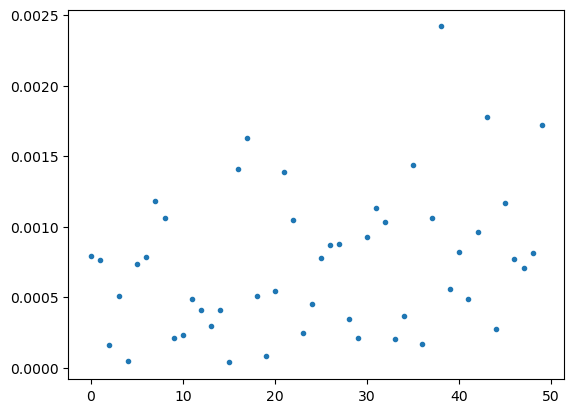

In [267]:
# means = np.mean(X, 0)
k = 9
plt.plot(np.abs(X[k] - means), '.')
np.mean(np.abs(X[k] - means))

0.000746977615212985

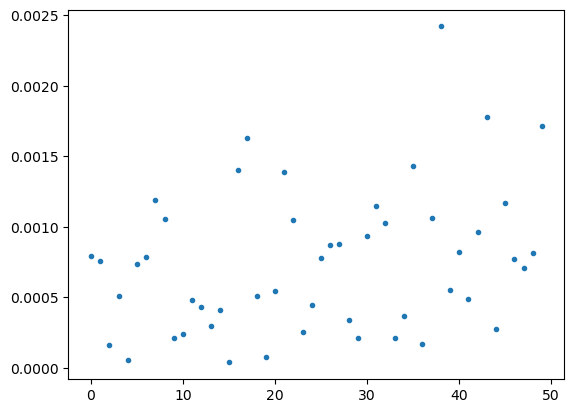

In [229]:
# means = np.mean(X, 0)
k = 2
plt.plot(np.abs(X[k] - means), '.')
np.mean(np.abs(X[k] - means))

In [152]:
y

array([0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
       0., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
       0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 1., 1., 0., 1.,
       0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
       0., 0., 1., 0., 0., 0., 0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.,
       0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
       0., 0., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0.,
       0., 0., 0., 0., 0.

In [153]:
X[:3]

array([[1.05563984e-03, 1.22078757e-06, 1.57731045e-03, 9.68068772e-03,
        7.38237890e-05, 8.83501498e-05, 2.70693341e-06, 2.01184809e-03,
        1.55496096e-03, 7.29229914e-04, 5.33025542e-03, 4.59170283e-03,
        1.42624302e-06, 2.43449694e-02, 8.48541271e-04, 4.23812405e-04,
        1.73730653e-03, 1.95245419e-06, 4.78149124e-03, 3.59178544e-06,
        3.59637534e-06, 2.77658330e-06, 1.08579053e-06, 2.46211964e-03,
        8.77269401e-04, 1.36487660e-06, 8.25302355e-06, 2.51661472e-03,
        2.83650768e-04, 2.40289816e-04, 8.93093150e-04, 2.14122990e-05,
        7.13650501e-05, 1.58274825e-05, 1.90139821e-06, 1.38902892e-03,
        5.82087817e-07, 4.87275003e-03, 5.90412752e-06, 2.56932243e-06,
        3.50530514e-03, 6.41834522e-05, 2.38836419e-03, 1.16056413e-03,
        3.42051460e-04, 2.67472520e-06, 1.03234424e-03, 1.99663745e-03,
        1.95711137e-06, 2.60831787e-03],
       [1.04599813e-03, 1.67409320e-06, 1.58387650e-03, 9.68546067e-03,
        7.34150338e-05,

In [150]:
pred = np.mean(pred, axis = 1)
pred

array([0.02, 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.  ,
       0.02, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.  ,
       0.  , 0.02, 0.  , 0.02, 0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.02, 0.02, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.

[0. 1. 0.]


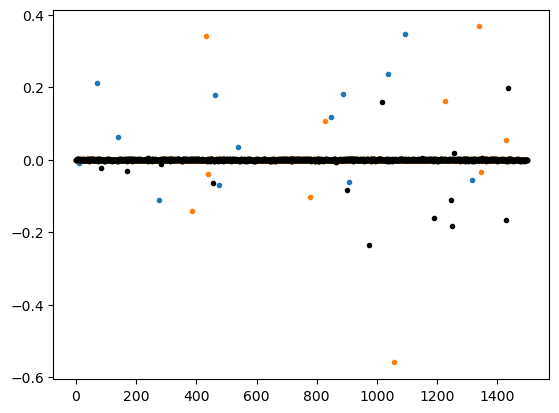

In [96]:
# plt.plot(X[:, 5][y != 1], '.')
# plt.plot(X[:, 5][y  == 1], '.')
plt.plot(X[1] - means, '.')
plt.plot(X[2] - means, '.')
plt.plot(X[3] - means, '.', color = 'black')
print(y[:3])

In [397]:
class MyModel:
    def __init__(self):
        return
    def fit(self, X, y):
        y = y > 0.5

        self.mmin = np.min(X, axis= 0)

        X = X - self.mmin + 1e-3
        X = np.log(X)

        self.scaler = sklearn.preprocessing.MinMaxScaler().fit(X)

        X = self.scaler.transform(X)
        X = (X < 0.5)
        self.inverted = np.array([(np.sum(X[:, i][y]) > np.sum(X[:, i][~y])) for i in range(X.shape[1])])
    def predict(self, X):
        X = X - self.mmin+ 1e-3
        X = np.log(X)
        X = self.scaler.transform(X)
        X = (X < 0.5)
    
        classes = np.any(X[:, self.inverted], axis= 1) | np.all(X[:, ~self.inverted], axis= 1) 
        return classes
    


dataset_id = 7
X, y = read_data(dataset_id)
X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.1, stratify = y, shuffle=True)

model = MyModel()
model.fit(X_train, y_train)
y_train_pred = model.predict(X_train)
y_pred = model.predict(X_test)

np.mean(y_pred == y_test), np.mean(y_train_pred == y_train), sklearn.metrics.roc_auc_score(y_test, y_pred)



(0.87, 0.8744444444444445, 0.5)

In [238]:
np.sum(inverted != model.inverted)

10

In [50]:
from sklearn.decomposition import PCA
dataset_id = 6

alpha = 0.07
X, y  = read_data(dataset_id)
print(X.shape)
score_functions = [ACC(), ACC()] #, ASY(np.array([[-9, 9],[1, 0]]),), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [False, True] #, False,False]
sklearn_score_functions = {f'{get_name(sf)}_{i}': make_scorer(sf, greater_is_better=greater_is_better[i]) for i, sf in enumerate(score_functions)}
model = make_pipeline(
    StandardScaler(),
    GaussianNB()
)
rez = cross_validate(model, X, y, scoring= sklearn_score_functions, cv = 5, n_jobs= -2, return_train_score=True)



(1000, 200)


{'fit_time': array([0.00256729, 0.00252914, 0.0025878 , 0.00254083, 0.00273013]),
 'score_time': array([0.00046897, 0.00046062, 0.00054121, 0.00044107, 0.00054598]),
 'test_ACC_0': array([-0.665, -0.69 , -0.665, -0.655, -0.67 ]),
 'train_ACC_0': array([-0.68125, -0.67625, -0.67875, -0.6825 , -0.6775 ]),
 'test_ACC_1': array([0.665, 0.69 , 0.665, 0.655, 0.67 ]),
 'train_ACC_1': array([0.68125, 0.67625, 0.67875, 0.6825 , 0.6775 ])}

In [31]:
from sklearn import decomposition

pca = decomposition.KernelPCA(100, kernel='rbf')
pca.fit_transform(X)

array([[-7.98411466e+07, -1.16873205e+08, -2.75970829e+08, ...,
         8.15097813e+07,  3.41212977e+08, -2.06413322e+08],
       [-2.32795382e+07, -7.04274110e+07,  2.47894951e+08, ...,
        -1.72300057e+08,  2.55791565e+08, -4.14286216e+07],
       [ 1.52881009e+07, -4.95146278e+07,  4.58152864e+07, ...,
        -3.14608340e+08,  1.11475456e+08,  5.77485950e+06],
       ...,
       [-1.28054215e+08,  1.91880553e+08, -2.81788510e+08, ...,
         6.61712818e+08,  4.75765765e+08,  1.09261793e+08],
       [-2.94965037e+08, -1.22275357e+08, -2.35069417e+08, ...,
        -2.38461949e+08, -1.92114364e+08, -3.15504408e+08],
       [-5.84168316e+07, -1.50929193e+08,  6.74396707e+07, ...,
         1.87536962e+07, -3.54495124e+08, -1.67283708e+08]])

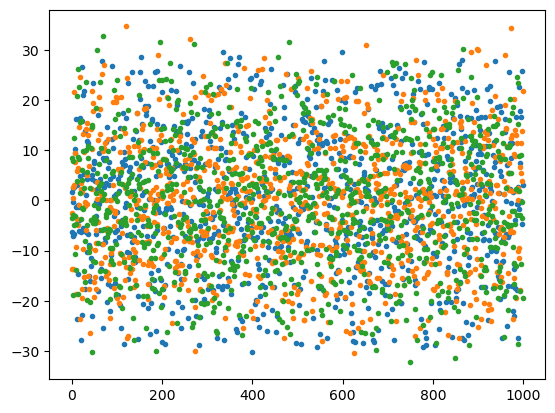

In [12]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components= 3, learning_rate='auto', init='random', perplexity=3)
X_tr = tsne.fit_transform(X, y =y)
plt.plot(X_tr, '.')

In [81]:
pd.DataFrame(StandardScaler.fit_transform(X)).describe()

AttributeError: 'numpy.ndarray' object has no attribute 'fit'

In [127]:
data = np.concatenate([X, y[:, None]], axis = 1)
pd.DataFrame(data).corr().round(3).style.background_gradient(cmap='coolwarm')

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,1.000,-0.032,-0.011,-0.019,-0.015,0.022,0.006,-0.006,-0.022,0.005,...,0.032,0.001,-0.000,0.012,-0.019,0.010,-0.010,-0.010,0.034,0.005
1,-0.032,1.000,-0.004,-0.008,-0.027,-0.007,-0.017,-0.004,-0.052,-0.005,...,-0.002,0.016,-0.053,-0.051,0.008,0.008,0.022,0.014,-0.054,0.009
2,-0.011,-0.004,1.000,0.061,0.014,-0.022,0.006,0.004,0.040,-0.033,...,0.012,0.019,0.013,0.067,-0.016,0.062,0.011,-0.015,0.006,-0.063
3,-0.019,-0.008,0.061,1.000,-0.016,-0.028,-0.014,0.036,0.028,-0.024,...,0.057,0.032,-0.037,0.043,0.003,0.016,-0.011,-0.007,-0.029,0.034
4,-0.015,-0.027,0.014,-0.016,1.000,-0.024,-0.025,0.008,-0.057,-0.022,...,0.033,0.051,0.053,-0.030,0.005,-0.026,-0.010,-0.005,0.020,-0.029
5,0.022,-0.007,-0.022,-0.028,-0.024,1.000,-0.038,-0.003,-0.006,-0.000,...,0.006,0.008,-0.016,-0.070,-0.024,0.031,-0.029,-0.005,0.001,0.011
6,0.006,-0.017,0.006,-0.014,-0.025,-0.038,1.000,-0.037,0.016,0.016,...,-0.010,-0.012,-0.048,0.023,0.035,0.033,0.034,0.024,-0.008,0.009
7,-0.006,-0.004,0.004,0.036,0.008,-0.003,-0.037,1.000,-0.002,0.020,...,0.057,-0.021,-0.020,0.057,-0.012,0.059,0.024,0.013,-0.057,-0.023
8,-0.022,-0.052,0.040,0.028,-0.057,-0.006,0.016,-0.002,1.000,-0.062,...,-0.002,0.012,-0.010,-0.106,0.013,0.047,0.043,-0.030,0.030,0.032
9,0.005,-0.005,-0.033,-0.024,-0.022,-0.000,0.016,0.020,-0.062,1.000,...,-0.008,-0.037,-0.061,-0.012,0.006,0.009,0.018,-0.080,0.000,-0.023


In [1]:
# importing the required libraries 
import seaborn as sbn 
import matplotlib.pyplot as plt 
# loading the dataset using the seaborn library 
# pairplot with the hue = gender parameter 
dataset_id = 11
alpha = 0.07
n = 10
X, y = read_data(dataset_id)
f, pv = feature_selection.f_classif(X, y)
p_vals = similarity_test(X, y, chi2_test).p_value

bound = sorted(p_vals)[n]
X = X[:, p_vals < bound]

data = pd.DataFrame(X)
data['target'] = y
sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 
# displaying the plot 
plt.show() 

NameError: name 'read_data' is not defined

In [210]:
np.mean(y == 0)

0.7817817817817818

In [132]:
# Init dataframe
from scipy.stats import chisquare
from statsmodels.stats.multitest import multipletests

def Behjamin_hohberg(p_val, alpha):                              # вызывалка поправки
    _, pv, *_ = multipletests(p_val, alpha, method = 'fdr_bh')
    return pv

def chi2_test(a, b):
    df_bins = pd.DataFrame()
    _, bins = pd.qcut(a, q = 10, retbins= True)
    df_bins['bin'] = pd.cut(a, bins= bins).value_counts().index
    df_bins['a_bin'] = pd.cut(a, bins = bins).value_counts().values
    df_bins['b_bin'] = pd.cut(b, bins = bins).value_counts().values
    df_bins['expected'] = df_bins['a_bin'] /np.sum(df_bins['a_bin']) *  np.sum(df_bins['b_bin'])
    stat, p_value = chisquare(df_bins['b_bin'], df_bins['expected'])
    return stat, p_value

def similarity_cross_test(X, f):
    # X.shape = (n_items, n_features)
    if not isinstance(X, pd.DataFrame):
        X = pd.DataFrame(X)
    rez = pd.DataFrame(index= X.columns, columns= X.columns)
    for col in  range(len(X.columns)):
        for row in range(len(X.columns)):
            rez.iloc[row,col] = f(X.iloc[:,row], X.iloc[:, col])
    return rez

def similarity_test(X, y, f):
    # X.shape = (n_items, n_features)
    if not isinstance(X, pd.DataFrame):
        X = pd.DataFrame(X)
    rez = pd.DataFrame(index= X.columns, columns= ['stat', 'p_value'])
    for ind in range(len(X.columns)):
        rez.iloc[ind] = f(X.iloc[:,ind][y > 0], X.iloc[:,ind][y == 0])
    return rez

In [135]:
table = similarity_cross_test(X, lambda a, b: chi2_test(a,b)[1]).round(3)
table.style.background_gradient(cmap='coolwarm')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,1.000000,0.644841,0.902447,0.303715,0.126807,0.009543,0.163426,0.003093,0.059298,0.166726,0.849819,0.752472,0.477630,0.177039,0.510149,0.000820,0.009004,0.032211,0.083854,0.441471
1,0.317412,1.000000,0.451756,0.051439,0.057332,0.116915,0.140089,0.041267,0.020533,0.119522,0.069883,0.217615,0.043052,0.017880,0.077489,0.010384,0.286323,0.008907,0.013596,0.463493
2,0.822245,0.596354,1.000000,0.205558,0.093725,0.320391,0.069841,0.033153,0.536232,0.352238,0.890508,0.418832,0.083054,0.552342,0.117356,0.013213,0.034003,0.039940,0.319014,0.554063
3,0.166139,0.206724,0.184732,1.000000,0.323815,0.392422,0.796201,0.107499,0.426027,0.268944,0.022435,0.927850,0.944497,0.348204,0.887697,0.007627,0.093457,0.301955,0.025372,0.473156
4,0.217100,0.457294,0.130043,0.611643,1.000000,0.011772,0.050812,0.028601,0.187965,0.242218,0.003602,0.130423,0.301485,0.119968,0.253661,0.004481,0.069980,0.455285,0.200785,0.108252
5,0.088945,0.324201,0.502436,0.265024,0.066262,1.000000,0.051619,0.459583,0.717264,0.376245,0.385778,0.621997,0.062453,0.743623,0.624286,0.087969,0.079385,0.311548,0.061586,0.908618
6,0.030675,0.106368,0.040771,0.380582,0.111568,0.032528,1.000000,0.000153,0.011498,0.183916,0.005781,0.181276,0.267194,0.004492,0.415182,0.024666,0.027701,0.135042,0.000210,0.057130
7,0.000021,0.000806,0.000176,0.067612,0.000110,0.124113,0.000060,1.000000,0.005233,0.001313,0.000319,0.003717,0.007213,0.001089,0.009017,0.000576,0.031974,0.002059,0.003213,0.024199
8,0.106263,0.417382,0.499565,0.298293,0.190449,0.190316,0.191625,0.017658,1.000000,0.188472,0.595245,0.741507,0.284532,0.694223,0.470364,0.112391,0.064900,0.799856,0.032609,0.552688
9,0.027087,0.210040,0.057832,0.043137,0.007007,0.005460,0.004488,0.000150,0.013769,1.000000,0.045010,0.064003,0.029405,0.020858,0.355466,0.006064,0.000505,0.001236,0.031634,0.241857


In [171]:
from statsmodels.stats.multitest import multipletests
alpha = 0.01
dataset_id = 10

X, y = read_data(dataset_id)

def Behjamin_hohberg(p_val, alpha):                              # вызывалка поправки
    _, pv, *_ = multipletests(p_val, alpha, method = 'fdr_bh')
    return pv

test_table = similarity_test(X, y, chi2_test)
p_vals = test_table.p_value
print(np.mean(p_vals < alpha))

p_vals = Behjamin_hohberg(p_vals, alpha)

print(np.mean(p_vals < alpha))

0.466
0.34


In [155]:
similarity_test(X, y, chi2_test)

,stat,p_value
0,7.999029,0.534244
1,21.393172,0.011015
2,18.630172,0.028528
3,20.301217,0.016142
4,11.876244,0.220376
5,9.911437,0.357702
6,21.849741,0.009368
7,12.214207,0.201501
8,19.231807,0.023292
9,20.607169,0.014514


## bayessian methods

In [7]:
import pymc as pm
import matplotlib.pyplot as plt
import arviz as az
import pandas as pd
from scipy import special, stats
import numpy as np

az.style.use("arviz-grayscale")
plt.rcParams['figure.dpi'] = 300


WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [48]:
from sklearn.cluster import KMeans
score_functions = [ACC(), None,  ASY(np.array([[-9, 9],[1, 0]]),), ASY(np.array([[-1, 3],[2, -1]]))]
asy1 = ASY(np.array([[-9, 9],[1, 0]]),)
asy2 = ASY(np.array([[-1, 3],[2, -1]]))


def generate_features(data, means):
    return np.linalg.norm(data[:, None, :] - means[None, :, :], axis= 2)

def fit_dataset(dataset_id):
    X, y = read_data(dataset_id)
    # X = X.sum(axis = 1)[:, None]
    scaler =  sklearn.preprocessing.StandardScaler()
    X = scaler.fit_transform(X, y)


    # X = np.concatenate([X, np.ones((len(X), 1))], axis=1)
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size=0.1, stratify = y, shuffle=True)

    transformer = KMeans(n_clusters= 10, ).fit(X_train)
    means = transformer.cluster_centers_
    X_train = 1/generate_features(X_train, means)**2
    X_test = 1/generate_features(X_test, means)**2
    
    n = X_train.shape[1]

    y = pd.Categorical(y)

# train model
    with pm.Model(coords={'idx': np.arange(n)}) as model_log_reg:
        X = pm.Data("X", X_train, mutable= True)
        y = pm.Data('y', y_train, mutable= True)
        mu = pm.Normal('mu', mu = 0., sigma = 100, dims = 'idx')
        sigmas = pm.Normal('sigmas', mu = 50., sigma = 20, dims = 'idx')
        w = pm.Normal('w', mu = mu, sigma = sigmas, dims='idx')
        mu = pm.math.dot(X, w)
        theta = pm.Deterministic('theta', pm.math.sigmoid(-mu))
        # print(theta.size)
        y_pred = pm.Bernoulli('y_pred', p = theta, observed = y)

        approx = pm.fit(n = 20_000) #, method='svgd')
        # trace_pred = pm.sample(1000, cores=6, random_seed= 100)
# predictions

    idata = approx.sample(30000)
    # az.plot_posterior(idata.posterior['sigmas'])
    with model_log_reg:
        pm.set_data({"X": X_test, 'y': np.zeros_like(y_test)})
        posterior_predictions = pm.sample_posterior_predictive(\
            idata.posterior, var_names=['theta', 'y_pred'])
    
    probs = az.summary(posterior_predictions.posterior_predictive.theta)['mean']
    
    print(f"id: {dataset_id} baseline:{np.mean(y_test == 0)} acc:{np.mean((probs > 0.5) == y_test)}, asy1: {asy1(y_test, y_prob =  1 - probs)}")
    return [np.mean(y_test == 0), np.mean((probs > 0.5) == y_test), asy1(y_test, y_prob = probs) ,asy2(y_test, y_prob = probs),  sklearn.metrics.roc_auc_score(y_test, probs)]
    

In [49]:
rez = []
for dataset_id in range(1, 5):
    rez. append(fit_dataset(dataset_id))

/Users/ilgam/miniconda3/envs/ml/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Finished [100%]: Average Loss = 690.14
Sampling: [y_pred]


arviz - WARNING - Shape validation failed: input_shape: (1, 30000), minimum_shape: (chains=2, draws=4)


id: 1 baseline:0.49 acc:0.52, asy1: -3.9


/Users/ilgam/miniconda3/envs/ml/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Finished [100%]: Average Loss = 685.67
Sampling: [y_pred]


arviz - WARNING - Shape validation failed: input_shape: (1, 30000), minimum_shape: (chains=2, draws=4)


id: 2 baseline:0.53 acc:0.53, asy1: -4.3


/Users/ilgam/miniconda3/envs/ml/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Finished [100%]: Average Loss = 686.84
Sampling: [y_pred]


arviz - WARNING - Shape validation failed: input_shape: (1, 30000), minimum_shape: (chains=2, draws=4)


id: 3 baseline:0.51 acc:0.54, asy1: -4.1


/Users/ilgam/miniconda3/envs/ml/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Finished [100%]: Average Loss = 487
Sampling: [y_pred]


arviz - WARNING - Shape validation failed: input_shape: (1, 30000), minimum_shape: (chains=2, draws=4)


id: 4 baseline:0.84 acc:0.84, asy1: -7.4


In [50]:
pd.DataFrame(data=rez, columns=['baseline', 'ACC', "ASY1", 'ASY2', 'auc'], index= range(1, 5))


,baseline,ACC,ASY1,ASY2,auc
1,0.49,0.52,-3.9,0.53,0.473389
2,0.53,0.53,-4.3,0.41,0.463468
3,0.51,0.54,-4.1,0.47,0.625050
4,0.84,0.84,-7.4,-0.52,0.591518


In [213]:
# predictions

idata = approx.sample(2000)
with model_log_reg:
    pm.set_data({"X": X_test, 'y': np.zeros_like(y_test)})
    posterior_predictions = pm.sample_posterior_predictive(\
        idata.posterior, var_names=['theta', 'y_pred'])

Sampling: [y_pred]


In [214]:
probs = az.summary(posterior_predictions.posterior_predictive.theta)['mean']
np.mean((probs > 0.5) == y_test)

arviz - WARNING - Shape validation failed: input_shape: (1, 2000), minimum_shape: (chains=2, draws=4)


0.83

0.5348837209302326


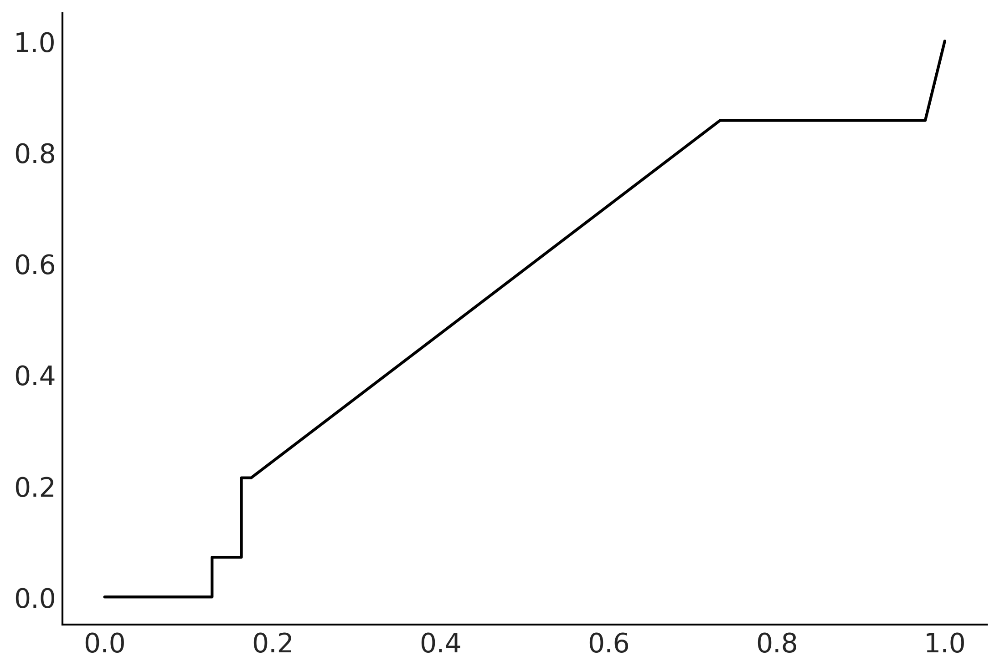

In [215]:
fpr, tpr, thresholds = sklearn.metrics.roc_curve(y_test, probs)
plt.plot(fpr, tpr)
print(sklearn.metrics.roc_auc_score(y_test, probs))

## Gaussian mixture features

In [311]:
score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]

def get_scores(X, y, model):
    probs = model.predict_proba(X)[:,1]
    scores = []
    for i, scorer in enumerate(score_functions):
        if i != 0:
            y_pred = scorer.prob_to_class(probs)
        else:
            y_pred = probs
        scores.append(scorer(y, y_pred))
    return scores

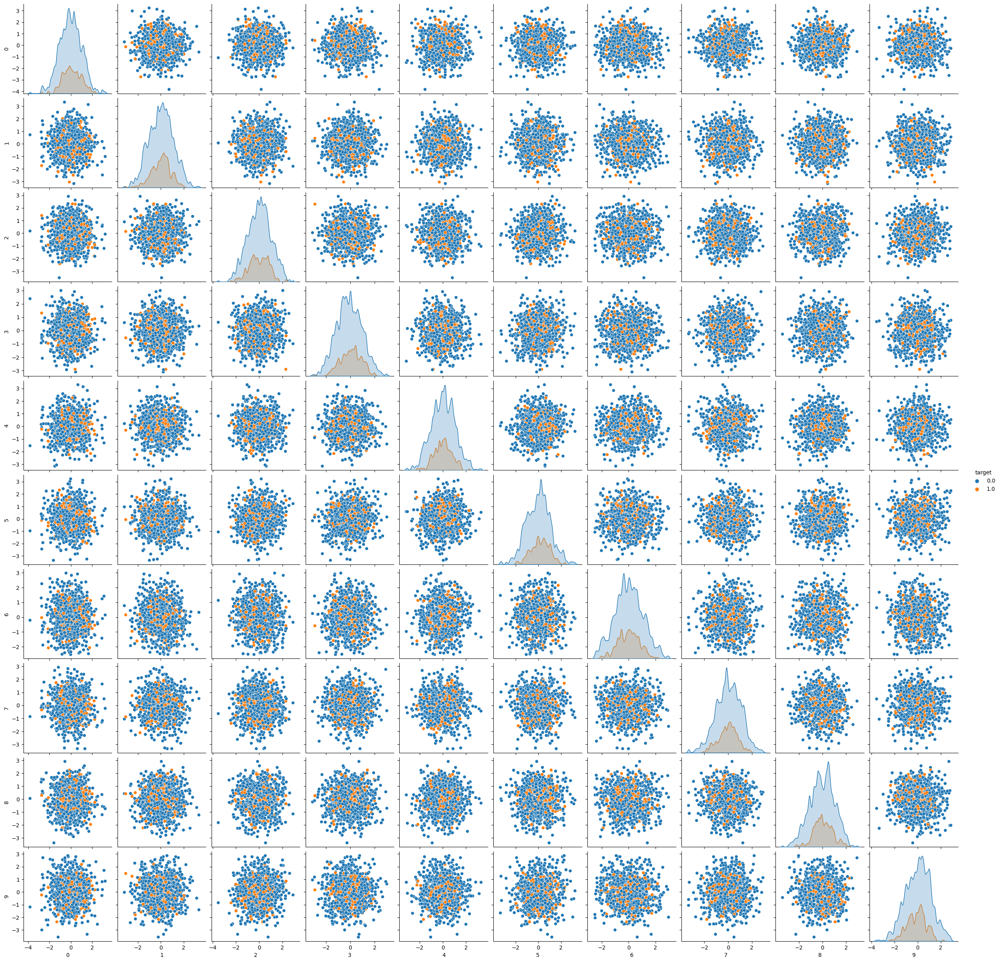

In [262]:
import seaborn as sbn
from mice import MiceImputer
dataset_id = 11
X, y = read_data(dataset_id)
ind_high = (X > 15) # np.quantile(X, 0.95, 0))
ind_low = (X < -15) #np.quantile(X, 0.05, 0))
mice_transformer = MiceImputer()
data = pd.DataFrame(X[:, :10])
data['target'] = y
sbn.pairplot(data, hue = 'target', diag_kws={'bw_adjust': 0.3}, diag_kind='kde') 

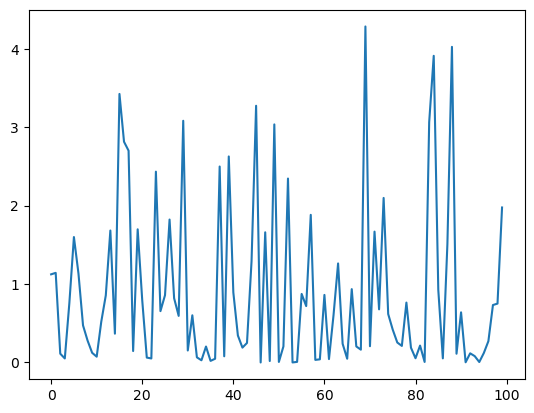

In [559]:
dataset_id = 12
X, y = read_data(dataset_id)
feature_selector = sklearn.feature_selection.SelectKBest().fit(X, y)
feature_scores = feature_selector.scores_
plt.plot(feature_scores, label = 'not mice')

# ind_high = (X > np.quantile(X, 0.95, 0))
# ind_low = (X < np.quantile(X, 0.05, 0))
# # print(np.sum(ind_high | ind_low))
# X[np.where(ind_high | ind_low)] = None
#     # код замены
# mice_transformer = MiceImputer()
# X = pd.DataFrame(X)
# X = mice_transformer.fit_transform(X, verbose= False).values

# feature_selector = sklearn.feature_selection.SelectKBest().fit(X, y)
# feature_scores = feature_selector.scores_
# plt.plot(feature_scores, label = 'mice')
# plt.legend()
# print(np.sum(feature_scores > 0.5))

In [245]:
X, y = read_data(dataset_id)
X_te = read_test_data(dataset_id)
X_b = np.concatenate([X, X_te], axis = 0)
ind_high = (X_b > 10. )
# ind_low = (X_b < -10. )
np.sum(ind_high , axis= 0)

array([ 8,  8, 10, 14,  8, 11,  8,  7, 10,  9, 16, 12,  8, 11, 10,  5,  7,
       10, 12,  6, 11, 12, 10, 10,  9,  8,  6, 11, 11, 13, 11, 14, 14, 11,
        6,  5,  7,  7,  6, 15, 19, 12, 17, 13,  7,  7,  7,  6, 11, 10])

In [9]:
from sklearn.naive_bayes import GaussianNB
from sklearn.calibration import CalibratedClassifierCV
score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]
from mice import MiceImputer
def get_scores(X, y, model):
    probs = model.predict(X)
    scores = []
    for i, scorer in enumerate(score_functions):
        if i != 0:
            y_pred = scorer.prob_to_class(probs)
        else:
            y_pred = probs
        scores.append(scorer(y, y_pred))
    return scores

from sklearn.model_selection import cross_validate
from joblib import Parallel, delayed

def train_val(X, y):
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.2, shuffle=True, stratify=y)

    param_dict = {'C': 0.01, 'class_weight': 'balanced', 'l1_ratio': 0.2, 'n_jobs': -1, 'penalty': 'elasticnet', 'solver': 'saga'}
    model = make_pipeline(
        sklearn.preprocessing.MinMaxScaler(),
        # sklearn.linear_model.ARDRegression()
        # sklearn.linear_model.LogisticRegression(**param_dict)
        sklearn.ensemble.RandomForestClassifier(n_estimators= 500, max_depth= 5,)
        # GaussianNB( )
        # sklearn.naive_bayes.ComplementNB()
    )
    model = CalibratedClassifierCV(model, cv = 3)
    model.fit(X_train, y_train)
    return get_scores(X_test, y_test, model)

train_val_parallel = delayed(train_val)
def check_dataset(dataset_id, iters):
    X, y = read_data(dataset_id)
    X_te = read_test_data(dataset_id)

    mice_transformer = MiceImputer(seed_strategy='mean')
    X_b = np.concatenate([X, X_te], axis = 0)
    qv = 0.01
    ind_high = (X_b > 50. ) #np.quantile(X_b, 1. - qv, 0))
    ind_low = (X_b < -50. ) # np.quantile(X_b, qv, 0))
    X_b[np.where(ind_high | ind_low)] = None
    X_b = pd.DataFrame(X_b)
    X_b = mice_transformer.fit_transform(X_b, verbose= False, iter = 30).values
    X = X_b[:X.shape[0]]

    # feature_selector = sklearn.feature_selection.SelectKBest().fit(X, y)
    # feature_scores = feature_selector.scores_
    # feature_indices = np.argsort(feature_scores)
    # # X = X[:, feature_scores > 1]
    # manifold = sklearn.manifold.TSNE(n_components=3)
    # X = manifold.fit_transform(X)
    print("noise filter fitted")
    cases = Parallel(n_jobs= 9)(train_val_parallel(X, y) for _ in range(iters))
    df = pd.DataFrame(np.stack(cases, axis = 0), columns=["AUC", "ACC", "ASY1", "ASY2"])
    return df


print("AUC   ACC   ASY1  ASY2")
rez = []
for dataset_id in [7]:
    rez.append(check_dataset(dataset_id, 100))

rez[0].describe()

AUC   ACC   ASY1  ASY2
noise filter fitted


,AUC,ACC,ASY1,ASY2
count,100.0,100.00,1.000000e+02,1.000000e+02
mean,0.5,0.87,-7.700000e+00,-6.100000e-01
std,0.0,0.00,3.570612e-15,1.115816e-16
min,0.5,0.87,-7.700000e+00,-6.100000e-01
25%,0.5,0.87,-7.700000e+00,-6.100000e-01
50%,0.5,0.87,-7.700000e+00,-6.100000e-01
75%,0.5,0.87,-7.700000e+00,-6.100000e-01
max,0.5,0.87,-7.700000e+00,-6.100000e-01


<Axes: ylabel='Density'>

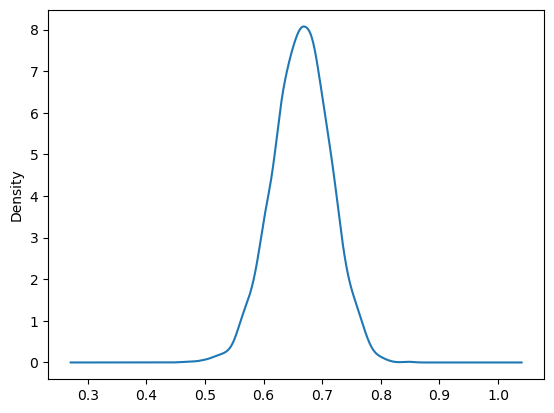

In [278]:
rez[0]['AUC'].plot.density()

In [279]:
np.mean(rez[0]['AUC'] > 0.7)

0.2366

independent datasets

In [578]:
score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]

dataset_id = 10
X, y = read_data(dataset_id)
X_test = read_test_data(dataset_id)
n_test = X_test.shape[0]

# AUC
auc_probs = pd.read_csv(f'./test_ans/task1_{dataset_id}_ans.csv')['AUC']
auc_probs = 1 - auc_probs
# ACC
pred_class = np.zeros_like(y)
print(np.mean(y == pred_class))

pred_class = np.zeros(n_test)
# ASY1
p = np.mean(y == 1)
label = (p > score_functions[2].p)
pred_asy1 = np.zeros_like(y) + label
print(score_functions[2](y, pred_asy1))
pred_asy1 = np.zeros(n_test) + label

# ASY2
p = np.mean(y == 1)
label = (p > score_functions[3].p)
pred_asy2 = np.zeros_like(y) + label
print(score_functions[3](y, pred_asy2))
pred_asy2 = np.zeros(n_test) + label

df = pd.DataFrame(np.stack([auc_probs, pred_class, pred_asy1, pred_asy2], axis = 1),
                   columns=['AUC', 'ACC', 'ASY1', 'ASY2'])

out_path = f"test_ans/task1_{dataset_id}_ans.csv"
df.to_csv(out_path, index = False)

0.61
-5.1
0.17


7 dataset

In [599]:
from collections import defaultdict
dataset_id = 7
X, y = read_data(dataset_id)
y = (y == 1)
        # код замены
alpha = 0.05

l_q = []
h_q = []
cliped_ind = defaultdict(lambda: 0)

for i in range(X.shape[1]):
    l, h = np.quantile(X[:, i], q=[alpha, 1 - alpha])
    l_q.append(l)
    h_q.append(h)
    indices = np.argwhere((X[:,i]> h) | (X[:,i] < l))
    for index in indices.T[0]:
        cliped_ind[index] += 1
    X[:,i] = np.clip(X[:,i], l, h) 

In [600]:
cliped_ind_class = defaultdict(lambda: [0, 0])
for key in cliped_ind.keys():
    cliped_ind_class[cliped_ind[key]][y[key]] += 1

/var/folders/ks/7b2rqlpx6j54hmxc16v83p980000gn/T/ipykernel_37861/907069697.py:3: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  cliped_ind_class[cliped_ind[key]][y[key]] += 1


In [601]:
cliped_ind_class

defaultdict(<function __main__.<lambda>()>,
            {9: [33, 5],
             4: [163, 21],
             7: [92, 12],
             8: [57, 8],
             5: [163, 25],
             6: [120, 21],
             2: [47, 11],
             12: [3, 0],
             11: [4, 2],
             3: [135, 19],
             10: [12, 5],
             1: [35, 3]})

In [6]:
from collections import defaultdict
dataset_id = 7
X, y = read_data(dataset_id)
l_q = []
h_q = []
cliped_ind = defaultdict(lambda: 0)

alpha = 0.05
for i in range(X.shape[1]):
    l, h = np.quantile(X[:, i], q=[alpha, 1 - alpha])
    l_q.append(l)
    h_q.append(h)
    indices = np.argwhere((X[:,i]> h) | (X[:,i] < l))
    for index in indices.T[0]:
        cliped_ind[index] += 1
    X[:,i] = np.clip(X[:,i], l, h) 
    
scaler = sklearn.preprocessing.MinMaxScaler().fit(X)
X = scaler.transform(X)
y = (y == 1)
means = np.mean(X, 0)
tmp = np.abs(X - means)
# tmp = (tmp > 0.05)
tmp = np.mean(tmp, axis=1)
# tmp = np.sort(tmp, axis = 1)
# solver = tmp[:, -2:]
# solver = solver[:,-1] / solver[:,-2]
# solver = solver 

# np.mean(solver != y)

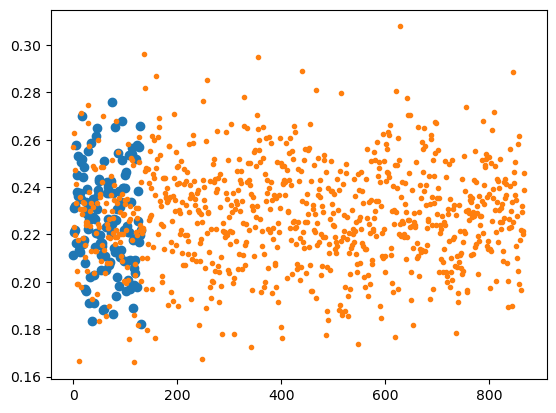

In [660]:
plt.plot(tmp[y == 1], 'o')
plt.plot(tmp[y != 1], '.')

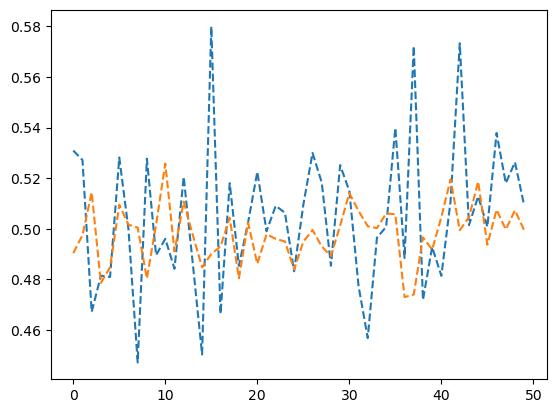

In [643]:
plt.plot(np.mean((X)[y], axis=0),'--')
plt.plot(np.mean((X)[~y], axis=0), '--')

In [644]:
np.std((X - means)[y == 1], axis =0)

array([0.2719619 , 0.28400792, 0.2402097 , 0.3027885 , 0.28073032,
       0.29835339, 0.28134137, 0.28497592, 0.2833978 , 0.28387094,
       0.25148924, 0.27474093, 0.25744954, 0.26320287, 0.25998894,
       0.26981388, 0.2705614 , 0.29929514, 0.2856022 , 0.24755105,
       0.29672691, 0.25314711, 0.26013488, 0.26849191, 0.28170581,
       0.28813553, 0.27301669, 0.28226022, 0.26781784, 0.26173453,
       0.26409995, 0.26123209, 0.27652202, 0.27815745, 0.26291691,
       0.29276215, 0.27977259, 0.26458138, 0.26095848, 0.28404791,
       0.28140941, 0.284752  , 0.24751395, 0.26097539, 0.26389338,
       0.27922367, 0.27203356, 0.27906203, 0.2784843 , 0.26661999])

In [646]:
np.std((X - means)[y != 1], axis =0)

array([0.2826043 , 0.27253739, 0.27664593, 0.27561803, 0.27406842,
       0.28057117, 0.28313191, 0.27141692, 0.27640062, 0.26972537,
       0.2754959 , 0.27585679, 0.27666155, 0.27268084, 0.27831345,
       0.28066466, 0.27428377, 0.27747072, 0.26921341, 0.27870598,
       0.26961895, 0.27709797, 0.27451562, 0.27841838, 0.2750416 ,
       0.28047686, 0.27358024, 0.27135093, 0.27453712, 0.27501804,
       0.2724508 , 0.27246066, 0.27406268, 0.27474587, 0.2849906 ,
       0.26935579, 0.27985526, 0.26798883, 0.27935059, 0.28126621,
       0.28060039, 0.27778694, 0.27097534, 0.27541735, 0.27097867,
       0.27966863, 0.26918359, 0.27511255, 0.27911999, 0.27279786])

In [ ]:
dots = (np.mean((X)[y], axis=0) - np.mean((X)[~y], axis=0)) > 0

In [675]:
from sklearn import mixture
model0 = sklearn.neighbors.KernelDensity().fit(X[y == 0])
model1 = sklearn.neighbors.KernelDensity().fit(X[y != 0])

In [677]:
model0.score_samples(X[0:1]), model1.score_samples(X[0:1])

(array([-49.78262647]), array([-49.92673938]))

In [681]:
np.mean( y != pred)

0.758

0.99

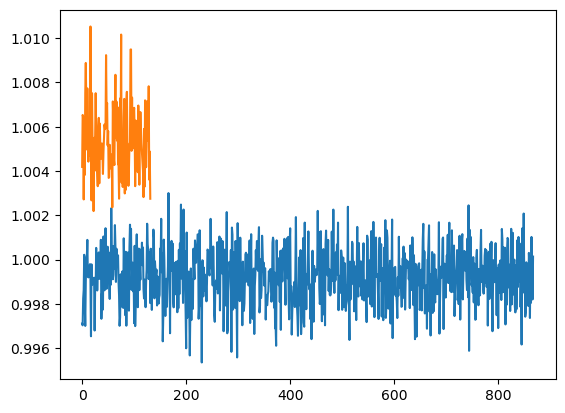

In [685]:
pred = (model0.score_samples(X) / model1.score_samples(X))
plt.plot(pred[y == 0])
plt.plot(pred[y != 0])
pred = (pred > 1.002)
np.mean(pred == y)

In [5]:
score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]

def get_scores(X, y, model):
    probs = model.predict_proba(X)#[:,1]
    scores = []
    for i, scorer in enumerate(score_functions):
        if i != 0:
            y_pred = scorer.prob_to_class(probs)
        else:
            y_pred = probs
        scores.append(scorer(y, y_pred))
    return scores

# get_scores(X, y, model)

In [590]:


def clip(X, alpha = 0.05):
    l_q = []
    h_q = []
    # cliped_ind = defaultdict(lambda: 0)

    for i in range(X.shape[1]):
        l, h = np.quantile(X[:, i], q=[alpha, 1 - alpha])
        l_q.append(l)
        h_q.append(h)
        # indices = np.argwhere((X[:,i]> h) | (X[:,i] < l))
        # for index in indices.T[0]:
            # cliped_ind[index] += 1
        X[:,i] = np.clip(X[:,i], l, h) 
    return X

score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]

def get_scores(X, y, model):
    probs = model.predict_proba(X)#[:,1]
    scores = []
    for i, scorer in enumerate(score_functions):
        if i != 0:
            y_pred = scorer.prob_to_class(probs)
        else:
            y_pred = probs
        scores.append(scorer(y, y_pred))
    return scores

from sklearn import mixture
class DencityModel:
    def __init__(self):
        pass    
    def fit(self, X, y):
        X = np.mean(X, axis=1)[:, None]
        self.model0 = sklearn.neighbors.KernelDensity(algorithm='ball_tree').fit(X[y == 0])#.reshape(-1, 1))
        self.model1 = sklearn.neighbors.KernelDensity(algorithm='ball_tree').fit(X[y != 0])#reshape(-1, 1))
        self.q = 1
    def predict_proba(self, X):
        X = np.mean(X, axis=1)[:, None]
        pred0 = np.exp(self.model0.score_samples(X))
        pred1 = np.exp(self.model1.score_samples(X))
        return pred1/(pred0 + pred1)
    

from sklearn import mixture
class DencityModelGauss:
    def __init__(self):
        pass    
    def fit(self, X, y):
        X = np.mean(X, axis=1)[:, None]
        self.model0 = sklearn.mixture.BayesianGaussianMixture().fit(X[y == 0])
        self.model1 = sklearn.mixture.BayesianGaussianMixture().fit(X[y != 0])
        self.q = 1
    def predict_proba(self, X):
        X = np.mean(X, axis=1)[:, None]
        pred0 = np.exp(self.model0.score_samples(X))
        pred1 = np.exp(self.model1.score_samples(X))
        a = 1.
        return pred1/(pred0* a + pred1)

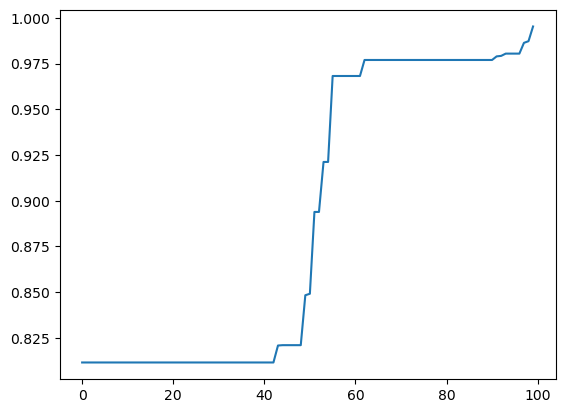

In [553]:
dataset_id = 12
X = read_test_data(dataset_id)
from statsmodels.stats.multitest import multipletests

from scipy.stats import normaltest
alpha = 0.05
pvals = normaltest(X)[1]
_, pvals, *_ = multipletests(pvals, alpha, method = 'fdr_bh')
plt.plot(sorted(pvals))

In [ ]:
dataset_id = 12
X = read_test_data(dataset_id)


In [555]:
dataset_id = 12
X, y = read_data(dataset_id)
idx = (pvals < 0.85)
print((np.mean(X[:,idx][y == 1], axis = 0) - np.mean(X[:, idx][y != 1], axis = 0)))

[ 0.06722123 -0.02289625  0.05897586  0.085895   -0.06727011 -0.04648413
  0.04505562 -0.06244925 -0.03999896 -0.10927915  0.11101993 -0.02469904
  0.05414014 -0.05989578 -0.11337498  0.02650146  0.05143248  0.01664036
  0.02871483 -0.00937291  0.01497335 -0.1037111  -0.06288375 -0.03785944
  0.07719852 -0.11495652  0.00093835 -0.08348174  0.00897125 -0.1147811
  0.06019235  0.09168027 -0.01316945 -0.01362245 -0.07442728  0.03166217
  0.03031166  0.02600913 -0.13734252  0.03063822 -0.09511894 -0.03302209
  0.02950919 -0.03008055 -0.1113043   0.13009477  0.08369218 -0.13185802
 -0.0523221   0.01839848  0.05688819]


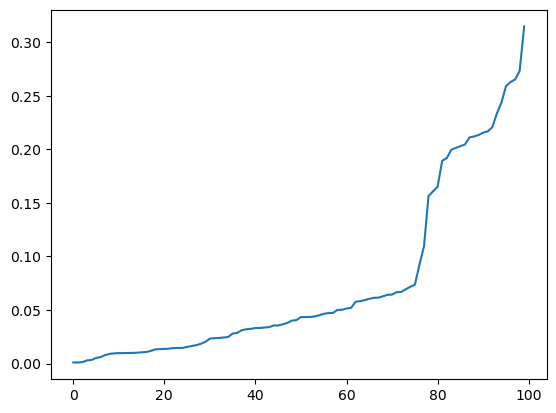

In [524]:
plt.plot(sorted(np.abs(np.std(X[y == 1], axis = 0) - np.std(X[y != 1], axis = 0))))

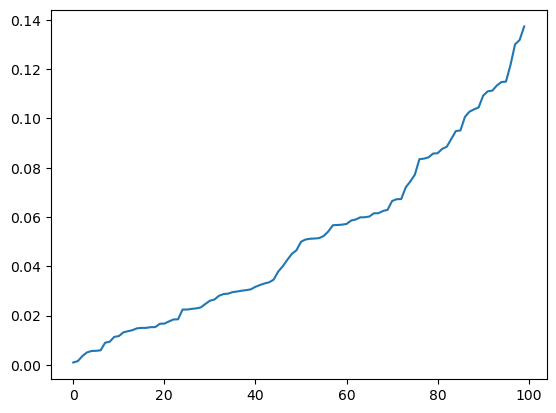

In [525]:
plt.plot(sorted(np.abs(np.mean(X[y == 1], axis = 0) - np.mean(X[y != 1], axis = 0))))

<Axes: ylabel='Density'>

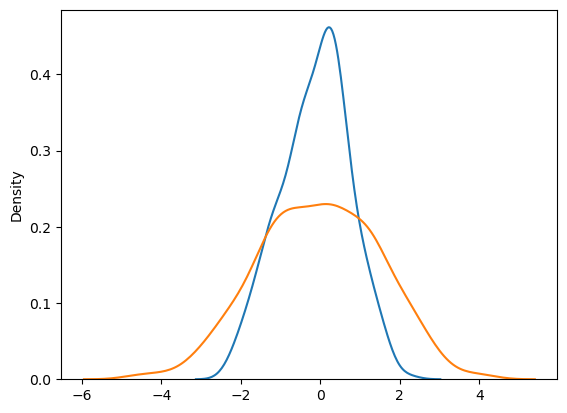

In [536]:
import seaborn as sns
ind = np.argmax(np.abs(np.mean(X[y == 1], axis = 0) - np.mean(X[y != 1], axis = 0)))
sns.kdeplot((X[:, ind])[y == 1])
sns.kdeplot((X[:, ind] - X[:, 1])[y != 1])

In [601]:
dataset_id = 6
X, y = read_data(dataset_id)
# std_ind = np.argsort(np.abs(np.std(X[y == 1], axis = 0) - np.std(X[y != 1], axis = 0)))[-20:]
# mean_ind = np.argsort(np.abs(np.mean(X[y == 1], axis = 0) - np.mean(X[y != 1], axis = 0)))[-5:]
# means = np.mean(X[:, std_ind], axis = 0)
# X = np.concatenate([(X[:, std_ind] - means)**2, X[:, mean_ind]], axis = 1)
# X = X[:, idx]
iretate_scores = []

def iterator():
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size= 0.3, stratify = y, shuffle=True)

    scaler = StandardScaler().fit(X_train)
    X_train = scaler.transform(X_train)
    X_test = scaler.transform(X_test)

    model = DencityModel()
    model.fit(X_train, y_train)
    scores = get_scores(X_test, y_test, model)
    return scores
    # iretate_scores.append(scores)

delayed_iter = delayed(iterator)
iretate_scores = Parallel(n_jobs= 8)(delayed_iter() for _ in range(5000))

df = pd.DataFrame(data = iretate_scores, columns=['AUC', "ACC", "ASY1", "ASY2"])
df.describe()

,AUC,ACC,ASY1,ASY2
count,5000.000000,5000.000000,5.000000e+03,5000.000000
mean,0.758477,0.676134,-4.133333e+00,0.109901
std,0.023049,0.023021,8.882673e-16,0.061451
min,0.673857,0.583333,-4.133333e+00,-0.136667
25%,0.743151,0.660000,-4.133333e+00,0.070000
50%,0.758784,0.676667,-4.133333e+00,0.106667
75%,0.774195,0.693333,-4.133333e+00,0.150000
max,0.834460,0.756667,-4.133333e+00,0.333333


In [149]:
score_functions = [ sklearn.metrics.roc_auc_score, ACC(), ASY(np.array([[-9, 9],[1, 0]])), ASY(np.array([[-1, 3],[2, -1]]))]
greater_is_better = [True, True, False, False]

def get_preds(X, model):
    probs = model.predict_proba(X)
    if len(probs.shape) == 2:
        probs = probs[:,1]
    predictions = []
    for i, scorer in enumerate(score_functions):
        if i != 0:
            y_pred = scorer.prob_to_class(probs).astype(int)
        else:
            y_pred = probs
        predictions.append(y_pred)
    return predictions


In [604]:
dataset_id = 6
X_train, y_train =read_data(dataset_id)
X_test = read_test_data(dataset_id)
scaler = StandardScaler().fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

# feature_selector = sklearn.feature_selection.SelectKBest().fit(X_train, y_train)
# feature_scores = feature_selector.scores_
# feature_indices = np.argsort(feature_scores)
# X_train = X_train[:, feature_indices[1:]]
# X_test = X_test[:, feature_indices[1:]]

model = DencityModel()
model.fit(X_train, y_train)

predictions = get_preds(X_test, model)

df = pd.DataFrame()
for i, nam in enumerate(['AUC','ACC', 'ASY1', 'ASY2']):
    df[nam] = predictions[i]
out_path = f"test_ans/task1_{dataset_id}_ans.csv"
df.to_csv(out_path, index = False)


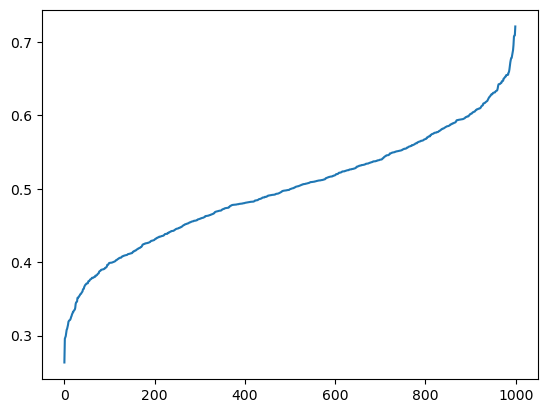

In [608]:
plt.plot(sorted(probs))

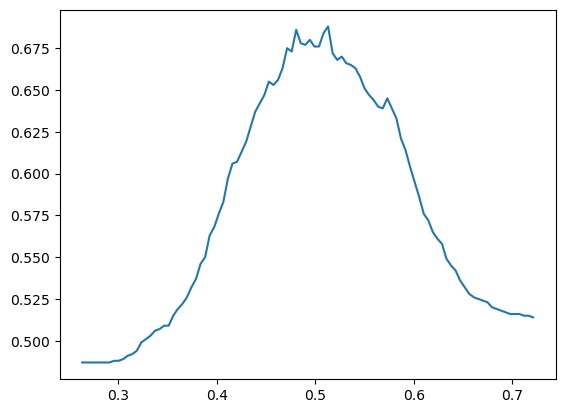

In [606]:
probs = model.predict_proba(X_train)
rang = np.linspace(min(probs), max(probs), 100)
acc_s = []
for r in rang:
    predict = probs > r
    acc_s.append( np.mean(predict == y) )
plt.plot(rang, acc_s)

In [607]:
max(acc_s)

0.688

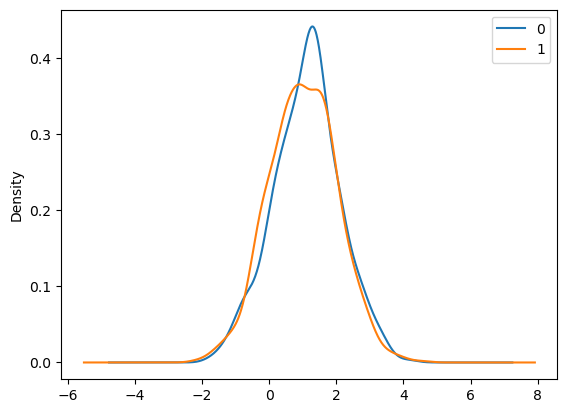

In [489]:
p0 = model.model0.sample(1000).T[0]
p1 = model.model1.sample(1000).T[0]
df = pd.DataFrame()
df['0'] = p0.T
df['1'] = p1.T
df.plot.density()
plt.legend()

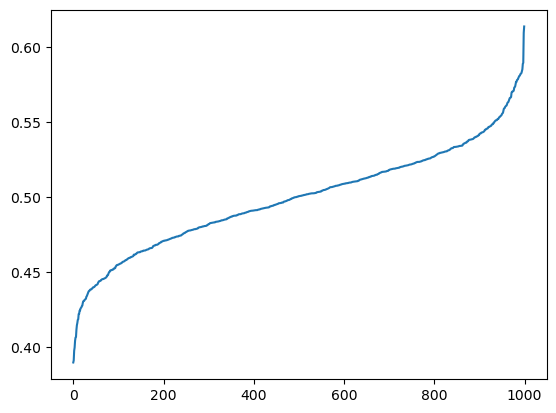

In [423]:
from scipy.special import kl_div
dataset_id = 2
X_train, y_train =read_data(dataset_id)
X_test = read_test_data(dataset_id)
scaler = StandardScaler().fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

feature_selector = sklearn.feature_selection.SelectKBest(sklearn.feature_selection.mutual_info_classif).fit(X_train, y_train)
feature_scores = feature_selector.scores_
feature_indices = np.argsort(feature_scores)

X_train_ = X_train[:, feature_indices[17:]]
X_test_ = X_test[:, feature_indices[17:]]
model = DencityModelGauss()
model.fit(X_train_, y_train)

plt.plot(sorted(model.predict_proba(X_test_)))


In [371]:
predictions = get_preds(X_train, model)
np.sum(predictions[0] > 0.55)
# np.sum(np.array(predictions[0]) > 0.55)

346

7 dataset

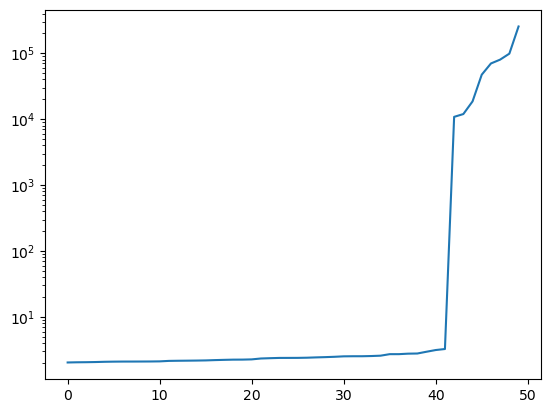

In [248]:
dataset_id = 7
# X, y = read_data(dataset_id)
# X_te = read_test_data(dataset_id)
# X_b = np.concatenate([X, X_te], axis = 0)
plt.plot(sorted(X_b[:,0])[1950:])
plt.yscale('log')

In [250]:
sorted(X_b[:, 0])[-20:]

[2.52512593830947,
 2.5337735484972375,
 2.534110835422603,
 2.552206187818935,
 2.5835803532067185,
 2.7247192857434666,
 2.7253983347498845,
 2.7725944671295704,
 2.787346965441904,
 2.965682760205077,
 3.147335822559407,
 3.2601328204518216,
 10836.319170284483,
 11949.557684508867,
 18585.82985356522,
 47288.69339449204,
 69958.48993922246,
 80023.0537273375,
 98545.3237186132,
 254583.09016796053]

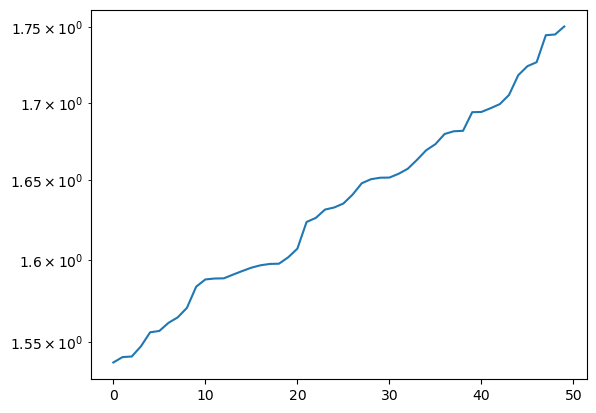

In [205]:
plt.plot(sorted(X_b[:, 1])[1950:])
plt.yscale('log')

In [425]:
dataset_id = 7
X, y = read_data(dataset_id)
X_te = read_test_data(dataset_id)

mice_transformer = MiceImputer()
X_b = np.concatenate([X, X_te], axis = 0)
ind_high = (X_b > 50.) #np.quantile(X_b, 0.95, 0))
ind_low = (X_b <  -50. ) #np.quantile(X_b, 0.1, 0))
X_b[np.where(ind_high | ind_low)] = None
X_b = pd.DataFrame(X_b)
X_b = mice_transformer.fit_transform(X_b, verbose= False, iter = 10).values

X =    X_b[:X.shape[0]]
X_te = X_b[X.shape[0]:]

feature_selector = sklearn.feature_selection.SelectKBest().fit(X, y)
feature_scores = feature_selector.scores_
feature_indices = np.argsort(feature_scores)
X = X[:, feature_indices[-10:]]
X_te = X_te[:, feature_indices[-10:]]

model = GaussianNB()
model.fit(X, y)
print('fitted')
predictions = get_preds(X_te, model)

df = pd.DataFrame()
for i, nam in enumerate(['AUC','ACC', 'ASY1', 'ASY2']):
    df[nam] = predictions[i]
out_path = f"test_ans/task1_{dataset_id}_ans.csv"
df.to_csv(out_path, index = False)


fitted


<Axes: ylabel='Density'>

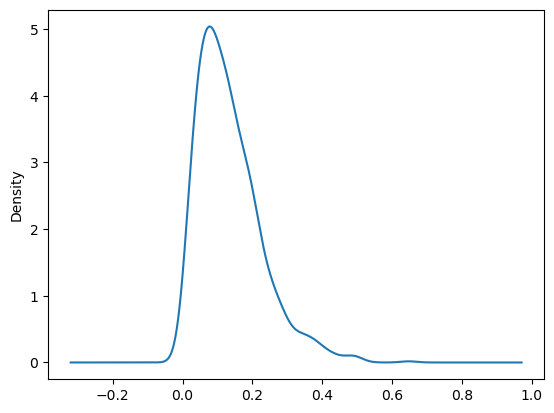

In [281]:
pd.Series(predictions[0]).plot.density()

<Axes: ylabel='Density'>

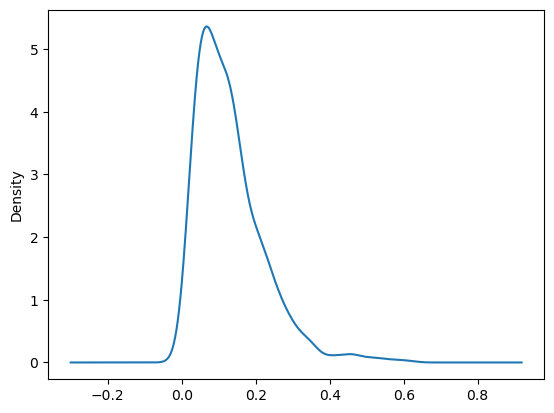

In [282]:
predictions = get_preds(X, model)
pd.Series(predictions[0]).plot.density()

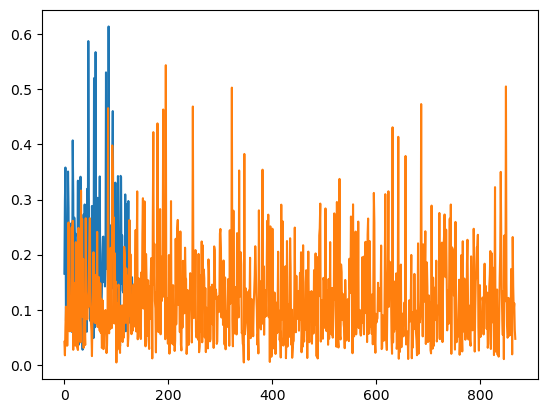

In [255]:
plt.plot(predictions[0][y == 1])
plt.plot(predictions[0][y != 1])